# Rossmann Store Sales
 <a href="https://www.kaggle.com/c/rossmann-store-sales" target="_blank">Source: Kaggle</a>
 
 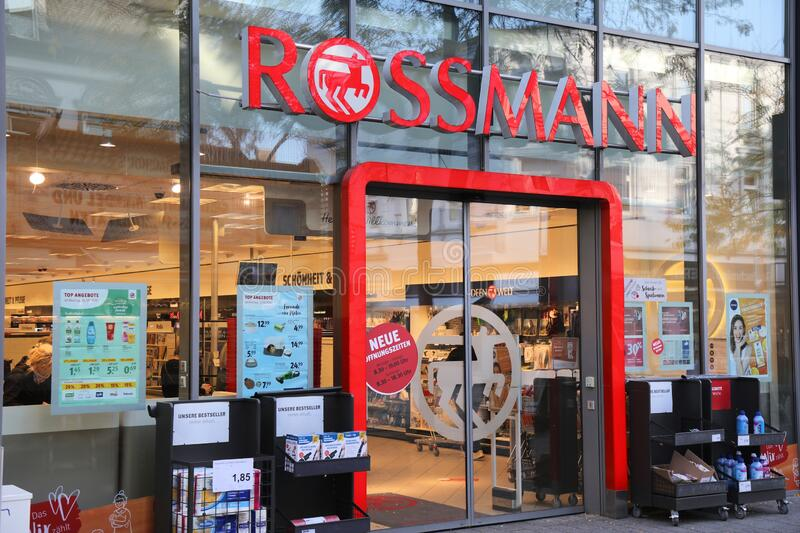

## Business Problem

### Business Understanding

Rossmann operates over 3,000 drug stores in 7 European countries. Currently, Rossmann store managers are tasked with predicting their daily sales for up to six weeks in advance. Store sales are influenced by many factors, including promotions, competition, school and state holidays, seasonality, and locality. 
With thousands of individual managers predicting sales based on their unique circumstances, the accuracy of results can be quite varied. (kaggle.com)

### Business Question

What will be the sales per store for the next 6 weeks?

### Data Science Challenge

Develop a standardized methodology for sales forecasting.

### Project Plan

<font size=5>CRISP-DS (Cross-Industry Standard Process for Data Science).</font>

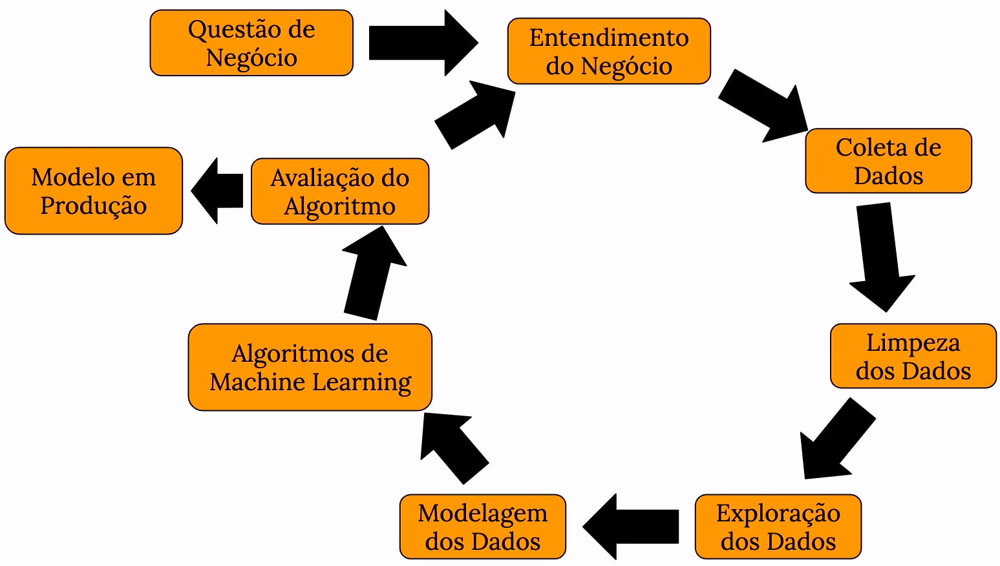
<font size=4>Source: Meigarom Lopes, DS em Produção</font>

#### Data Product

API in Telegram that receives the store number and returns the sales forecast.

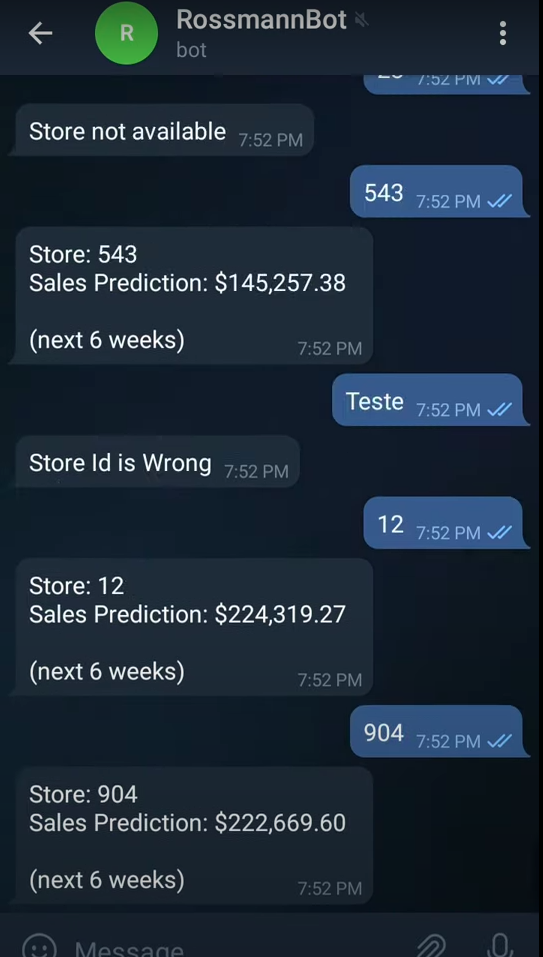

# Enviroment

## Installations

In [ ]:
!pip install -r requirements.txt

In [21]:
#!pip install pandas
#!pip install inflection
#!pip install seaborn
#!pip install plotly
#!pip install tabulate
#!pip install boruta
#!pip install XGBoost
#!pip uninstall scikit-learn -y
#!pip install -U scikit-learn

ERROR: Could not find a version that satisfies the requirement peakle (from versions: none)
ERROR: No matching distribution found for peakle


## Imports

In [1]:
# Data extraction
import pandas     as pd
import inflection

# Transformation
import math
import numpy    as np
from   datetime import datetime
from   datetime import timedelta
import missingno as msno

# Exploratory Data Analysis
import seaborn             as sns
from   tabulate            import tabulate
import matplotlib
from   scipy.stats         import chi2_contingency
import plotly.express      as px
from   IPython.display     import Image
import matplotlib.pyplot   as plt
from   matplotlib.gridspec import GridSpec
import plotly.graph_objects as go
import emoji
from operator import attrgetter


# Modeling
from boruta                import BorutaPy
import xgboost             as xgb
from sklearn.metrics       import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
from sklearn.ensemble      import RandomForestRegressor
from sklearn.linear_model  import LinearRegression, Lasso
from sklearn.preprocessing import MinMaxScaler, RobustScaler, LabelEncoder
import random
import pickle

# API
from flask import Flask, request, Response
import json
import requests

# Others
import warnings

## Settings

In [2]:
# Suprimir notação científica no Pandas
pd.set_option('display.float_format', lambda x: '%.2f' % x)
matplotlib.rcParams['figure.figsize'] = (16, 8)
sns.set_style("darkgrid")
warnings.simplefilter(action='ignore')

## Fuctions

### Transformations

#### Rename Columns

In [6]:
def rename_columns(data, verbose=True):
    '''
    --> Renames DataFrame columns to snake_case standard
    
    :param data: DataFrame to raname columns
    :param verbose: Confirmation message
    '''
    cols_old = ['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo', 'StateHoliday', 
                         'SchoolHoliday', 'StoreType', 'Assortment', 'CompetitionDistance', 
                         'CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek', 
                         'Promo2SinceYear', 'PromoInterval']

    # snacke case standard
    snackecase = lambda x: inflection.underscore(x)
    cols_new = list(map(snackecase, cols_old))
    data.columns = cols_new
    if verbose:
        print('Columns have been renamed')

#### Change dtypes

In [7]:
def change_dtypes(data):
    '''
    --> Change data types
    
    :param data: DataFrame to change data types
    '''
    data['competition_open_since_month'] = data['competition_open_since_month'].astype(int)
    data['competition_open_since_year'] = data['competition_open_since_year'].astype(int)
    data['promo2_since_week'] = data['promo2_since_week'].astype(int)
    data['promo2_since_year'] = data['promo2_since_year'].astype(int)
    print(data.dtypes)

#### Fill promo interval

In [8]:
def fill_promo_interval(data):
    '''
    --> Fill column promo_interval and create the column is_promo
    
    :param data: DataFrame to fill and create column 
    '''
    month_map = {1: 'Jan',
                2: 'Feb',
                3: 'Mar',
                4: 'Apr',
                5: 'May',
                6: 'Jun',
                7: 'Jul',
                8: 'Aug',
                9: 'Sep',
                10: 'Oct',
                11: 'Nov',
                12: 'Dec'}

    data['promo_interval'].fillna(0, inplace=True)

    # Auxiliar feature - will be dropped
    data['month_map'] = data['date'].dt.month.map(month_map)

    # New feature
    data['is_promo'] = data[['promo_interval', 'month_map']].apply(lambda x: 0 if x['promo_interval'] == 0 else 1 if x['month_map'] in x['promo_interval'].split(',') else 0, axis=1)
    print('Operation performed successfully')

#### Feature Engineering

In [40]:
def feature_engineering(data, verbose=True):
    '''
    --> Derive new features
    
    :param data: DataFrame to create new features
    :param verbose: Print information about the steps realized
    '''
    #------------------------------------------------Time Features------------------------------------------
    # year
    data['year'] = data['date'].dt.year

    # month
    data['month'] = data['date'].dt.month

    # day
    data['day'] = data['date'].dt.day

    # week of year
    data['week_of_year'] = data['date'].dt.isocalendar().week

    # year week
    data['year_week'] = data['date'].dt.strftime('%Y-%W')

    # competition since - year and month
    data['competition_since'] = data.apply(lambda x: datetime(year=x['competition_open_since_year'], month=x['competition_open_since_month'], day=1), axis=1)

    # Number of months of competition
    data['competition_time_month'] = ((data['date'] - data['competition_since']) / 30).apply(lambda x: x.days).astype(int)

    # promo since - date of started promotion
    # Unfeasible in CRISP 2
    #data['promo_since'] = data['promo2_since_year'].apply(lambda x: str(x) + '-' + data['promo2_since_week'].astype(str) if x != 0 else x)
    #data['promo_since'] = data['promo_since'].apply(lambda x: datetime.strptime(x + '-1', '%Y-%W-%w') - timedelta(days=7) if x != 0 else x)

    # promo_time_week - number of weeks of promotion
    # Unfeasible in CRISP 2
    #data['promo_time_week'] = ((data['date'] - data['promo_since']) / 7).apply(lambda x: x.days).astype(int)

    #--------------------------------------------------Readability-------------------------------------------
    # Assortment - readable format
    data['assortment'] = data['assortment'].apply(lambda x: 'basic' if x == 'a' else 'extra' if x == 'b'else 'extended')

    # state holiday - readable format
    data['state_holiday'] = data['state_holiday'].apply(lambda x: 'public_holiday' if x == 'a' else 'easter_holiday' if x == 'b' else 'christmas' if x == 'c' else 'regular_day')
    
    if verbose:
        print('''
        ----------------------------------------------------------
        Columns created:
        
        year
        month
        day
        week_of_year
        year_week
        competition_since
        competition_time_month
        
        ----------------------------------------------------------
        Improves readability 
        
        assortment
        state_holiday
        
        ----------------------------------------------------------
        New features have been created in DataFrame
        ''')

### Exploratory Data Analysis

#### Graph title

In [38]:
def graph_info(title=str):
    '''
    --> Add information about the graph
    
    :param title: Title of a graph
    '''
    plt.title(title, loc='left', fontsize=18, pad=15.5);

#### Cramer V

In [11]:
def cramer_v(x, y):
    '''
    --> Categorical variable correlation calc
    
    :param x: column 1
    :param y: column 2
    
    return cramer v correlation
    '''
    #cm: crosstab matrix apply to categoricals variables  
    #n: sum of crosstab matrix 
    #r: rows
    #k: columns
    cm = np.array(pd.crosstab(x, y))
    n = cm.sum()
    r, k = cm.shape
    chi2 = chi2_contingency(cm)[0]
    chi2_corr = max(0, chi2 - (k - 1) * (r - 1) / (n - 1))

    kcorr = k - (k - 1) ** 2 / (n - 1)
    rcorr = r - (r - 1) ** 2 / (n - 1)

    return np.sqrt((chi2_corr / n) / (min(kcorr - 1, rcorr - 1)))

#### Print message alert

In [12]:
def alert(text):
    '''
    --> Observation about the data
    
    :text: Observation to print
    '''
    print(emoji.emojize(f':light_bulb: {text}', use_aliases=True))

#### Descriptive numerical data

In [13]:
def descriptive_numerical_data(numerical_attributes, columns_included=['sales', 'customers', 
                                                                        'competition_distance', 
                                                                        'competition_open_since_month', 
                                                                        'competition_open_since_year', 
                                                                        'promo2_since_week', 
                                                                        'promo2_since_year']):
    '''
    --> Show descriptive statistics about the data
    
    :param numerical_attributes: DataFrame to extrac numerical attributes and show descriptive statistics
    :param columns_included: Columns to visualize statistics
    '''
    # Central Tendency - mean and median
    ct1 = pd.DataFrame(numerical_attributes.apply(np.mean))
    ct2 = pd.DataFrame(numerical_attributes.apply(np.median))

    # Dispersion - std, min, max, range, skew, kurtosis 
    d1 = pd.DataFrame((numerical_attributes).apply(np.std))
    d2 = pd.DataFrame(numerical_attributes).apply(min)
    d3 = pd.DataFrame(numerical_attributes).apply(max)
    d4 = pd.DataFrame(numerical_attributes).apply(lambda x: x.max() - x.min())
    d5 = pd.DataFrame(numerical_attributes).apply(lambda x: x.skew())
    d6 = pd.DataFrame(numerical_attributes).apply(lambda x: x.kurtosis())

    # Concatenate

    m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6], axis=1).reset_index()
    m.columns = ['features', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
    display(m.query("features == @columns_included"))

### Machine Learning

In [3]:
def ml_error(model_name=None, y=None, yhat=None):
    '''
    --> Measure the performance of a model 
    
    :param model_name: The name of ML model
    :param y: The real values to validate model performance
    :param yhat: The values predicted by the model to validade
    
    return: DataFrame with the name of a model and mae, mape and mrse measures
    '''
    mae = mean_absolute_error(y, yhat)
    mape = mean_absolute_percentage_error(y, yhat)
    mrse = np.sqrt(mean_squared_error(y, yhat))
    
    return pd.DataFrame({
        'Model Name': model_name,
        'MAE': mae,
        'MAPE': mape,
        'RMSE': mrse
    }, index=[0])

In [4]:
def cross_validation(x_training, model, model_name, kfold, verbose=False):
    mae_list = list()
    mape_list = list()
    mrse_list = list()
    for k in reversed(range(1, kfold+1)):
        if verbose:
            print(f'\nK number: {k}')
        validation_start_date = x_training['date'].max() - timedelta(days=k * 6 * 7)
        validation_end_date = x_training['date'].max() - timedelta(days=(k - 1) * 6 * 7)

        # Training
        # All data that have smaller date than validation_start_date
        training = x_training[x_training['date'] < validation_start_date]

        # Validation
        # All data that have grather or iqual than validation_start_date
        validation = x_training[(x_training['date'] >= validation_start_date) & (x_training['date'] <= validation_end_date)]

        # Training and validation dataset
        # Training
        xtraining = training.drop(['sales', 'date'], axis=1)
        ytraining = training['sales']

        # Validation
        xvalidation = validation.drop(['sales', 'date'], axis=1) 
        yvalidation = validation['sales']

        # Model
        m = model.fit(xtraining, ytraining)

        # Prediction
        yhat = m.predict(xvalidation)

        # Performance
        m_error = ml_error(model_name, np.expm1(yvalidation), np.expm1(yhat))
        mae_list.append(m_error['MAE'])
        mape_list.append(m_error['MAPE'])
        mrse_list.append(m_error['MRSE'])
        
    results = pd.DataFrame({
                            'Model': model_name,
                            'MAE CV': np.round(np.mean(mae_list), 2).astype(str) + ' +- ' + np.round(np.std(mae_list), 2).astype(str),
                            'MAPE CV': np.round(np.mean(mape_list), 2).astype(str) + ' +- ' + np.round(np.std(mape_list), 2).astype(str),
                            'MRSE CV': np.round(np.mean(mrse_list), 2).astype(str) + ' +- ' + np.round(np.std(mrse_list), 2).astype(str),
                        }, index=[0])
        
    return results

## DataFrames Dictionaries

In [59]:
tab = [
    ['DataFrame', 'Description'],
    ['df_sales_raw', 'historical data including Sales'],
    ['df_store_raw', 'supplemental information about the stores'],
    ['df_raw', 'merge of df_sales_raw and df_store_raw'],
    ['df1', 'equal to df_raw'],
    ['df1_c2', 'equal to df_raw to work no 2º CRISP cycle'],
    ['df2', 'Result of transformations step'],
    ['df2_c2', 'Result of transformations step in CRISP 2']
]

print(tabulate(tab, headers='firstrow'))

DataFrame     Description
------------  -----------------------------------------
df_sales_raw  historical data including Sales
df_store_raw  supplemental information about the stores
df_raw        merge of df_sales_raw and df_store_raw
df1           equal to df_raw
df1_c2        equal to df_raw to work no 2º CRISP cycle
df2           Result of transformations step
df2_c2        Result of transformations step in CRISP 2


# Data Extraction

## Data Load

In [37]:
# Read data available on Kaggle
df_sales_raw = pd.read_csv('../data/rossmann-store-sales/train.csv')
df_store_raw = pd.read_csv('../data/rossmann-store-sales/store.csv')

/home/marcos/Documents/data_science_em_producao/env_ds_producao/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3444: DtypeWarning: Columns (7) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [39]:
print('Sales raw')
df_sales_raw.head()

Sales raw


,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1


In [40]:
print('Store raw')
df_store_raw.head()

Store raw


,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.00,9.00,2008.00,0,NaN,NaN,NaN
1,2,a,a,570.00,11.00,2007.00,1,13.00,2010.00,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.00,12.00,2006.00,1,14.00,2011.00,"Jan,Apr,Jul,Oct"
3,4,c,c,620.00,9.00,2009.00,0,NaN,NaN,NaN
4,5,a,a,29910.00,4.00,2015.00,0,NaN,NaN,NaN


In [41]:
print('Merge df_sales_raw and df_store_raw')
df_raw = pd.merge(df_sales_raw, df_store_raw, how='inner', on='Store')
df_raw.head()

Merge df_sales_raw and df_store_raw


,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.00,9.00,2008.00,0,NaN,NaN,NaN
1,1,4,2015-07-30,5020,546,1,1,0,1,c,a,1270.00,9.00,2008.00,0,NaN,NaN,NaN
2,1,3,2015-07-29,4782,523,1,1,0,1,c,a,1270.00,9.00,2008.00,0,NaN,NaN,NaN
3,1,2,2015-07-28,5011,560,1,1,0,1,c,a,1270.00,9.00,2008.00,0,NaN,NaN,NaN
4,1,1,2015-07-27,6102,612,1,1,0,1,c,a,1270.00,9.00,2008.00,0,NaN,NaN,NaN


## Data Fiels

<b>Id</b> - an Id that represents a (Store, Date) duple within the test set

<b>Store</b> - a unique Id for each store

<b>Sales</b> - the turnover for any given day (this is what you are predicting)

<b>Customers</b> - the number of customers on a given day

<b>Open</b> - an indicator for whether the store was open: 0 = closed, 1 = open

<b>StateHoliday</b> - indicates a state holiday. Normally all stores, with few exceptions, are closed on state holidays. Note that all schools are closed on public holidays and weekends. a = public holiday, b = Easter holiday, c = Christmas, 0 = None

<b>SchoolHoliday</b> - indicates if the (Store, Date) was affected by the closure of public schools

<b>StoreType</b> - differentiates between 4 different store models: a, b, c, d

<b>Assortment</b> - describes an assortment level: a = basic, b = extra, c = extended

<b>CompetitionDistance</b> - distance in meters to the nearest competitor store

<b>CompetitionOpenSince[Month/Year]</b> - gives the approximate year and month of the time the nearest competitor was opened

<b>Promo</b> - indicates whether a store is running a promo on that day

<b>Promo2</b> - Promo2 is a continuing and consecutive promotion for some stores: 0 = store is not participating, 1 = store is participating

<b>Promo2Since[Year/Week]</b> - describes the year and calendar week when the store started participating in Promo2

<b>PromoInterval</b> - describes the consecutive intervals Promo2 is started, naming the months the promotion is started anew. E.g. "Feb,May,Aug,Nov" means each round starts in February, May, August, November of any given year for that store

## Output

File with all changes made in this step

In [ ]:
#df_raw.to_csv('../dados/procedimentos/df_raw.csv', index=False)

# Transformations

## Input

Previous step file

In [3]:
# CRISP 1
df1 = pd.read_csv('../data/processing/df_raw.csv')

In [41]:
# CRISP 2
df1_c2 = pd.read_csv('../data/processing/df_raw.csv')

## Rename Columns

In [5]:
# CRISP 1
cols_old = ['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo', 'StateHoliday', 
                     'SchoolHoliday', 'StoreType', 'Assortment', 'CompetitionDistance', 
                     'CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek', 
                     'Promo2SinceYear', 'PromoInterval']

# snacke case standard
snackecase = lambda x: inflection.underscore(x)
cols_new = list(map(snackecase, cols_old))
df1.columns = cols_new
df1.sample()

In [42]:
# CRISP 2
rename_columns(df1_c2)

Columns have been renamed


## Dimensions

In [8]:
print(f'Number of rows: {df1.shape[0]}')
print(f'Number of columns: {df1.shape[1]}')

Number of rows: 1017209
Number of columns: 18


## Types

In [11]:
# CRISP 1
df1['date'] = pd.to_datetime(df1['date'])
df1.dtypes

store                                    int64
day_of_week                              int64
date                            datetime64[ns]
sales                                    int64
customers                                int64
open                                     int64
promo                                    int64
state_holiday                           object
school_holiday                           int64
store_type                              object
assortment                              object
competition_distance                   float64
competition_open_since_month           float64
competition_open_since_year            float64
promo2                                   int64
promo2_since_week                      float64
promo2_since_year                      float64
promo_interval                          object
dtype: object

In [43]:
# CRISP 2
df1_c2['date'] = pd.to_datetime(df1_c2['date'])
df1_c2.dtypes

store                                    int64
day_of_week                              int64
date                            datetime64[ns]
sales                                    int64
customers                                int64
open                                     int64
promo                                    int64
state_holiday                           object
school_holiday                           int64
store_type                              object
assortment                              object
competition_distance                   float64
competition_open_since_month           float64
competition_open_since_year            float64
promo2                                   int64
promo2_since_week                      float64
promo2_since_year                      float64
promo_interval                          object
dtype: object

## Missing

In [23]:
df1.isna().sum()

store                                0
day_of_week                          0
date                                 0
sales                                0
customers                            0
open                                 0
promo                                0
state_holiday                        0
school_holiday                       0
store_type                           0
assortment                           0
competition_distance              2642
competition_open_since_month    323348
competition_open_since_year     323348
promo2                               0
promo2_since_week               508031
promo2_since_year               508031
promo_interval                  508031
dtype: int64

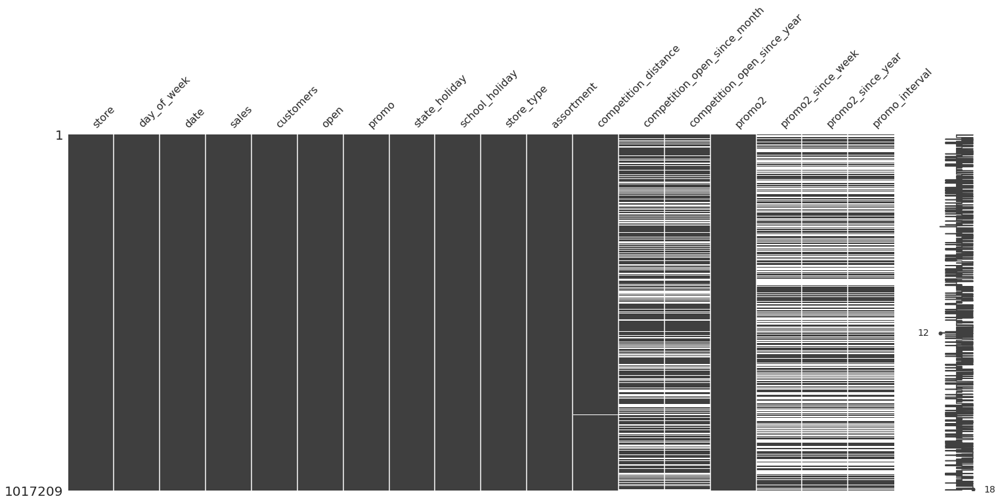

In [24]:
msno.matrix(df1);

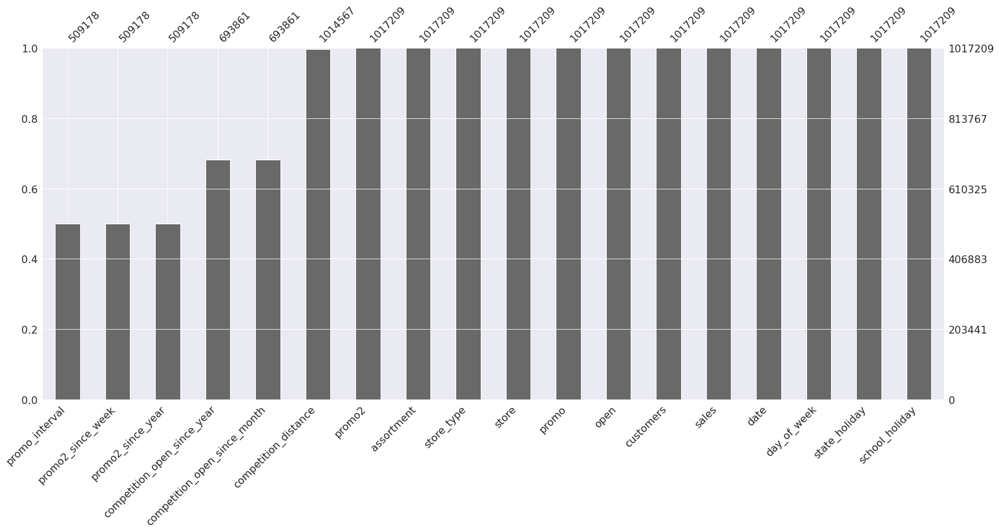

In [23]:
msno.bar(df1, sort='ascending');

## Fill NaN

### competition_distance              

Represents distance from nearest competitor

Assumption:
1. There are no related competitors
2. The information was not collected
3. Distance to competitor is too long

Methods:
1. Fill in with a value greater than the longest observed distance

    - Advantage: 
        Easy to implement
    - Disadvantage: 
        Does not consider column distribution
        
        
2. Fill in the rows with a random number between the 1st quartile and the 3nd quartile

    - Advantage: 
        Consider column distribution
    - Disadvantage: 
        Reinforces distribution bias

#### CRISP 1

In [9]:
# Treatment 1
print(f"Greater distance from the competitor: {df1['competition_distance'].max()}m")
df1['competition_distance'] = df1['competition_distance'].apply(lambda x: 200000.0 if math.isnan(x) else x)
print(f"Dados NaN restantes: {df1['competition_distance'].isna().sum()}")                 

Greater distance from the competitor: 75860.0m
Dados NaN restantes: 0


#### CRISP 2

<AxesSubplot:>

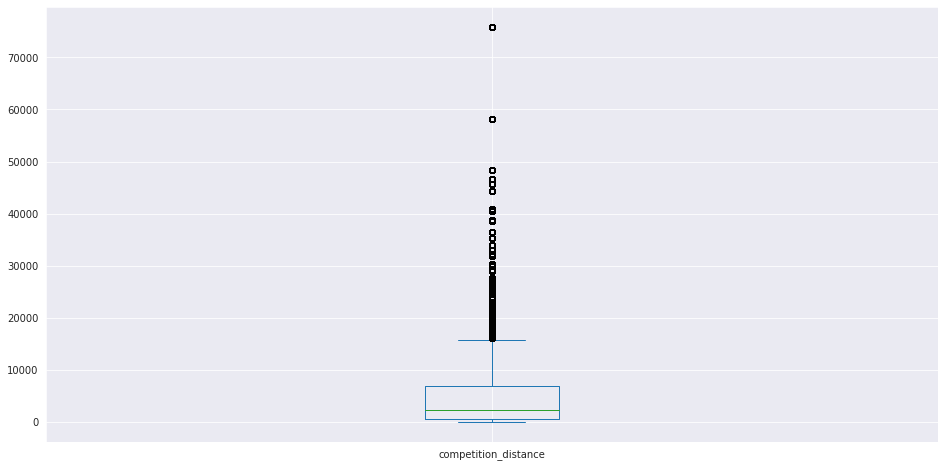

In [58]:
df1_c2['competition_distance'].plot(kind='box')

In [21]:
print('Competition Distance: Descriptive Statistical')
df1_c2['competition_distance'].describe()

Competition Distance: Descriptive Statistical


count   1017209.00
mean       5425.93
std        7706.25
min          20.00
25%         710.00
50%        2330.00
75%        6880.00
max       75860.00
Name: competition_distance, dtype: float64

In [44]:
# Fill nan
df1_c2['competition_distance'] = df1_c2['competition_distance'].apply(lambda x: random.randrange(710.00, 6890.00) if math.isnan(x) else x)

In [8]:
# Check nan
df1_c2['competition_distance'].isna().sum()

0

### competition_open_since_month

Represents approximately the month that the closest competitor opened the store

Assumption:
1. Lack of close competitor;
2. The next competitor opened the store before;
3. The competitor's opening date has not been recorded.

Methods:

1. Extract the month of the sale date, considering that sales are influenced by the date on which the next competitor opened.

    - Advantage: Easy to implement
    - Disadvantage: Does not consider that sales date changes over time 


2. Fill in the rows with a random number between the 1st quartile and the 3nd quartile   

    - Advantage: Consider column distribution
    - Disadvantage: Reinforces distribution bias

#### CRISP 1

In [12]:
df1['competition_open_since_month'] = df1.apply(lambda x: x['date'].month if math.isnan(x['competition_open_since_month']) else x['competition_open_since_month'], axis=1)

In [52]:
print(f'Dados faltantes na coluna: {df1["competition_open_since_month"].isna().sum()}')

Dados faltantes na coluna: 0


#### CRISP 2

<AxesSubplot:>

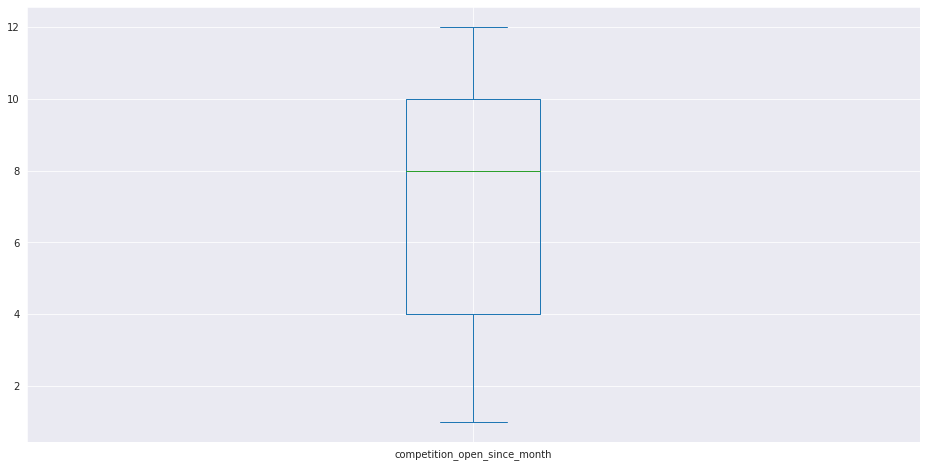

In [55]:
df1_c2['competition_open_since_month'].plot(kind='box')

In [45]:
# Fill nan
df1_c2['competition_open_since_month'] = df1_c2['competition_open_since_month'].apply(lambda x: random.randint(4, 10) if math.isnan(x) else x)

In [10]:
# Check nan
df1_c2['competition_open_since_month'].isna().sum()

0

### competition_open_since_year

Represents approximately the year the closest competitor opened the store

Assumption:
1. Lack of close competitor;
2. The next competitor opened the store before;
3. The competitor's opening date has not been recorded.

Methods:
1. Extract the year of the sale, considering that sales are influenced by the date on which the next competitor opened.

    - Advantage: Easy to implement
    - Disadvantage: Does not consider that sales date changes over time

2. Fill in the rows with a random number between the 1st quartile and the 3nd quartile

    - Advantage: Consider column distribution
    - Disadvantage: Reinforces distribution bias

#### CRISP 1

In [13]:
df1['competition_open_since_year'] = df1.apply(lambda x: x['date'].year if math.isnan(x['competition_open_since_year']) else x['competition_open_since_year'], axis=1)

In [68]:
print(f'Dados faltantes na coluna: {df1["competition_open_since_year"].isna().sum()}')

Dados faltantes na coluna: 0


#### CRISP 2

In [60]:
df1_c2['competition_open_since_year'].describe()

count   693861.00
mean      2008.69
std          5.99
min       1900.00
25%       2006.00
50%       2010.00
75%       2013.00
max       2015.00
Name: competition_open_since_year, dtype: float64

In [46]:
# Fill nan
df1_c2['competition_open_since_year'] = df1_c2['competition_open_since_year'].apply(lambda x: random.randint(2006, 2013) if math.isnan(x) else x)

In [12]:
# Check nan
df1_c2['competition_open_since_year'].isna().sum()

0

### promo2_since_week

Describes the calendar week when the store started participating in Promo2

Assumption:
1. The store was not participating in the promo 2

Methods:
1. Extract the week of the sale date, considering that sales are influenced by the date on which the next competitor opened.

    - Advantage: Easy to implement
    - Disadvantage: Does not consider that sales date changes over time


2. Fill in with 0, because the store was not participating

    - Advantage: Easy to implement
    - Disadvantage: May impact algorithm modeling

#### CRISP 1

In [14]:
df1['promo2_since_week'] = df1.apply(lambda x: x['date'].week if math.isnan(x['promo2_since_week']) else x['promo2_since_week'], axis=1)

In [70]:
print(f'Dados faltantes na coluna: {df1["promo2_since_week"].isna().sum()}')

Dados faltantes na coluna: 0


#### CRISP 2

In [68]:
# Check if promo2 == 0 and promo2_since_week is NaN
df1_c2[df1_c2['promo2_since_week'].isna() == True][['promo2_since_week', 'promo2']]

,promo2_since_week,promo2
0,NaN,0
1,NaN,0
2,NaN,0
3,NaN,0
4,NaN,0
...,...,...
1016262,NaN,0
1016263,NaN,0
1016264,NaN,0
1016265,NaN,0


In [47]:
# Fill nan
df1_c2['promo2_since_week'].fillna(0, inplace=True)

In [14]:
# Check nan
df1_c2['promo2_since_week'].isna().sum()

0

### promo2_since_year 

Describes the calendar year when the store started participating in Promo2

Assumption:

The store was not participating in the promo 2


Methods:
1. Extract the year of the sale date, considering that sales are influenced by the date on which the next competitor opened.

    - Advantage: Easy to implement
    - Disadvantage: Does not consider that sales date changes over time


2. Fill in with 0, because the store was not participating

    - Advantage: Easy to implement
    - Disadvantage: May impact algorithm modeling

#### CRISP 1

In [15]:
df1['promo2_since_year'] = df1.apply(lambda x: x['date'].year if math.isnan(x['promo2_since_year']) else x['promo2_since_year'], axis=1)

In [72]:
print(f'Dados faltantes na coluna: {df1["promo2_since_year"].isna().sum()}')

Dados faltantes na coluna: 0


#### CRISP 2

In [16]:
# Check if promo2 == 0 (not participating) and promo2_since_year == NaN
df1_c2[df1_c2['promo2_since_year'].isna() == True][['promo2_since_year', 'promo2']]

,promo2_since_year,promo2
0,NaN,0
1,NaN,0
2,NaN,0
3,NaN,0
4,NaN,0
...,...,...
1016262,NaN,0
1016263,NaN,0
1016264,NaN,0
1016265,NaN,0


In [48]:
# Fill nan
df1_c2['promo2_since_year'].fillna(0, inplace=True)

In [18]:
# Check nan
df1_c2['promo2_since_year'].isna().sum()

0

### promo_interval

Describes the consecutive intervals Promo2 is started, naming the months the promotion is started anew. E.g. "Feb,May,Aug,Nov" means each round starts in February, May, August, November of any given year for that store

Assumption:
1. The store didn't participate in the promotion

Methods:
1. Assign zero to NaN values

    - Advantage: Easy to implement
    - Disadvantage: May impact algorithm modeling

#### CRISP 1

In [16]:
# To create a new feature is_promo
month_map = {1: 'Jan',
            2: 'Feb',
            3: 'Mar',
            4: 'Apr',
            5: 'May',
            6: 'Jun',
            7: 'Jul',
            8: 'Aug',
            9: 'Sep',
            10: 'Oct',
            11: 'Nov',
            12: 'Dec'}

df1['promo_interval'].fillna(0, inplace=True)

# Auxiliar feature - will be dropped
df1['month_map'] = df1['date'].dt.month.map(month_map)

# New feature
df1['is_promo'] = df1[['promo_interval', 'month_map']].apply(lambda x: 0 if x['promo_interval'] == 0 else 1 if x['month_map'] in x['promo_interval'].split(',') else 0, axis=1)

In [74]:
print(f'Dados faltantes na coluna: {df1["promo_interval"].isna().sum()}')

Dados faltantes na coluna: 0


#### CRISP 2

In [49]:
fill_promo_interval(df1_c2)

Operation performed successfully


## Change Data Types

In [17]:
# CRISP 1
df1['competition_open_since_month'] = df1['competition_open_since_month'].astype(int)
df1['competition_open_since_year'] = df1['competition_open_since_year'].astype(int)
df1['promo2_since_week'] = df1['promo2_since_week'].astype(int)
df1['promo2_since_year'] = df1['promo2_since_year'].astype(int)
df1.dtypes

store                                    int64
day_of_week                              int64
date                            datetime64[ns]
sales                                    int64
customers                                int64
open                                     int64
promo                                    int64
state_holiday                           object
school_holiday                           int64
store_type                              object
assortment                              object
competition_distance                   float64
competition_open_since_month             int64
competition_open_since_year              int64
promo2                                   int64
promo2_since_week                        int64
promo2_since_year                        int64
promo_interval                          object
month_map                               object
is_promo                                 int64
dtype: object

In [50]:
# CRISP 2
change_dtypes(df1_c2)

store                                    int64
day_of_week                              int64
date                            datetime64[ns]
sales                                    int64
customers                                int64
open                                     int64
promo                                    int64
state_holiday                           object
school_holiday                           int64
store_type                              object
assortment                              object
competition_distance                   float64
competition_open_since_month             int64
competition_open_since_year              int64
promo2                                   int64
promo2_since_week                        int64
promo2_since_year                        int64
promo_interval                          object
month_map                               object
is_promo                                 int64
dtype: object


## Descriptive Statistical

In [18]:
# CRISP 1
num_attributes = df1.select_dtypes(include=['int64', 'float64'])
cat_attributes = df1.select_dtypes(exclude=['int64', 'float64', 'datetime64[ns]'])

In [51]:
# CRISP 2
num_attributes = df1_c2.select_dtypes(include=['int64', 'float64'])
cat_attributes = df1_c2.select_dtypes(exclude=['int64', 'float64', 'datetime64[ns]'])

### Numerical Attribues

#### CRISP 1

In [80]:
# Central Tendency - mean and median
ct1 = pd.DataFrame(num_attributes.apply(np.mean))
ct2 = pd.DataFrame(num_attributes.apply(np.median))

# Dispersion - std, min, max, range, skew, kurtosis 
d1 = pd.DataFrame((num_attributes).apply(np.std))
d2 = pd.DataFrame(num_attributes).apply(min)
d3 = pd.DataFrame(num_attributes).apply(max)
d4 = pd.DataFrame(num_attributes).apply(lambda x: x.max() - x.min())
d5 = pd.DataFrame(num_attributes).apply(lambda x: x.skew())
d6 = pd.DataFrame(num_attributes).apply(lambda x: x.kurtosis())

# Concatenate

m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6], axis=1).reset_index()
m.columns = ['features', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,features,min,max,range,mean,median,std,skew,kurtosis
0,store,1.00,1115.00,1114.00,558.43,558.00,321.91,-0.00,-1.20
1,day_of_week,1.00,7.00,6.00,4.00,4.00,2.00,0.00,-1.25
2,sales,0.00,41551.00,41551.00,5773.82,5744.00,3849.92,0.64,1.78
3,customers,0.00,7388.00,7388.00,633.15,609.00,464.41,1.60,7.09
4,open,0.00,1.00,1.00,0.83,1.00,0.38,-1.76,1.09
5,promo,0.00,1.00,1.00,0.38,0.00,0.49,0.49,-1.76
6,school_holiday,0.00,1.00,1.00,0.18,0.00,0.38,1.68,0.82
7,competition_distance,20.00,200000.00,199980.00,5935.44,2330.00,12547.65,10.24,147.79
8,competition_open_since_month,1.00,12.00,11.00,6.79,7.00,3.31,-0.04,-1.23
9,competition_open_since_year,1900.00,2015.00,115.00,2010.32,2012.00,5.52,-7.24,124.07


#### CRISP 2

In [52]:
descriptive_numerical_data(num_attributes)

,features,min,max,range,mean,median,std,skew,kurtosis
2,sales,0.00,41551.00,41551.00,5773.82,5744.00,3849.92,0.64,1.78
3,customers,0.00,7388.00,7388.00,633.15,609.00,464.41,1.60,7.09
7,competition_distance,20.00,75860.00,75840.00,5425.84,2330.00,7706.29,2.93,13.04
8,competition_open_since_month,1.00,12.00,11.00,7.15,7.00,2.88,-0.12,-1.04
9,competition_open_since_year,1900.00,2015.00,115.00,2008.95,2010.00,5.13,-8.32,157.49
11,promo2_since_week,0.00,50.00,50.00,11.65,1.00,15.32,1.00,-0.50
12,promo2_since_year,0.00,2015.00,2015.00,1007.01,2009.00,1005.88,-0.00,-2.00


<b>Skew</b>

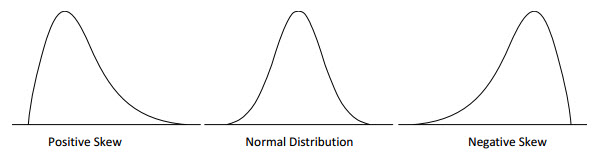

<b>Kurtosis</b>
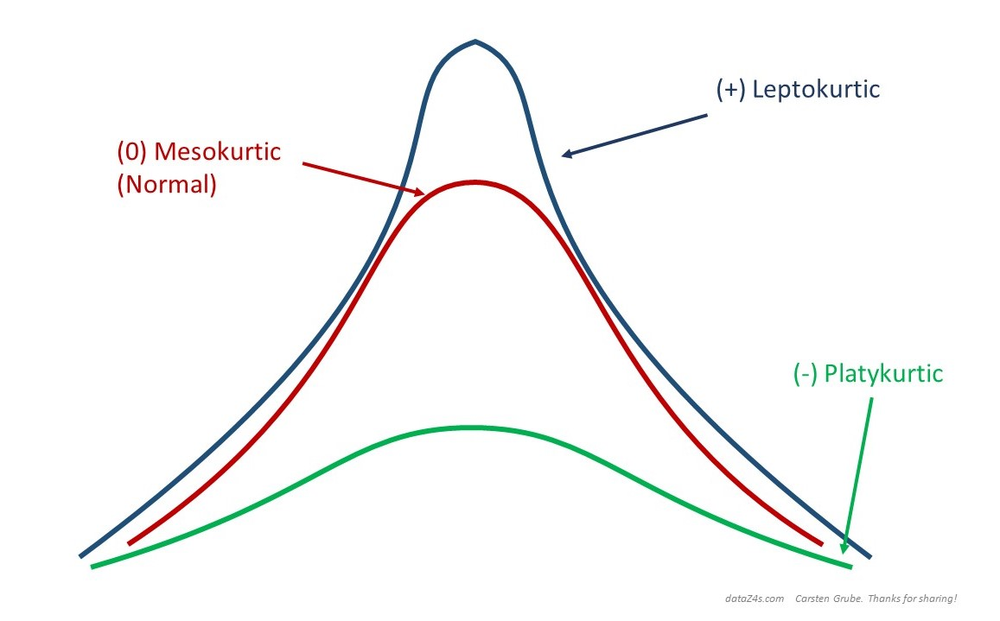

### Categorical Attributes

In [19]:
cat_attributes.apply(lambda x: x.unique().shape)

,state_holiday,store_type,assortment,promo_interval,month_map
0,4,4,3,4,12


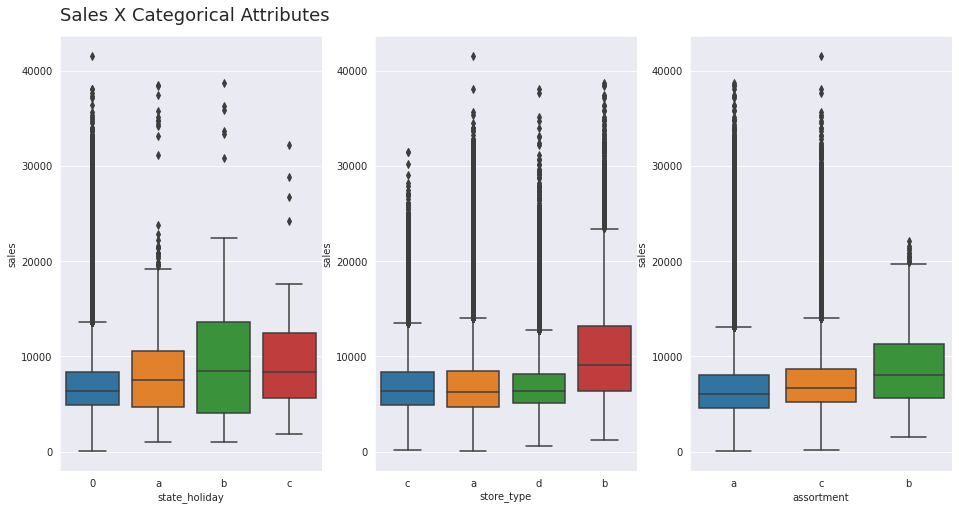

In [23]:
ax1 = df1[df1['sales'] > 0]
plt.subplot(1, 3, 1)
sns.boxplot(x='state_holiday', y='sales', data=ax1)
graph_info('Sales X Categorical Attributes')

plt.subplot(1, 3, 2)
sns.boxplot(x='store_type', y='sales', data=ax1)

plt.subplot(1, 3, 3)
sns.boxplot(x='assortment', y='sales', data=ax1)

plt.show()

<b>State Holiday</b>

a = public holiday 

b = Easter holiday

c = Christmas

0 = None

<b>Assortment</b>

a = basic 

b = extra 

c = extended

## Feature Engineering

### Mind Map Hypothesis

Mind Map Hypothesis

Phenomenon
- Sales forecast

Agents:
- Customers, stores, time and products

Agents attributes
- Image below

Hypothesis:
- Topics below

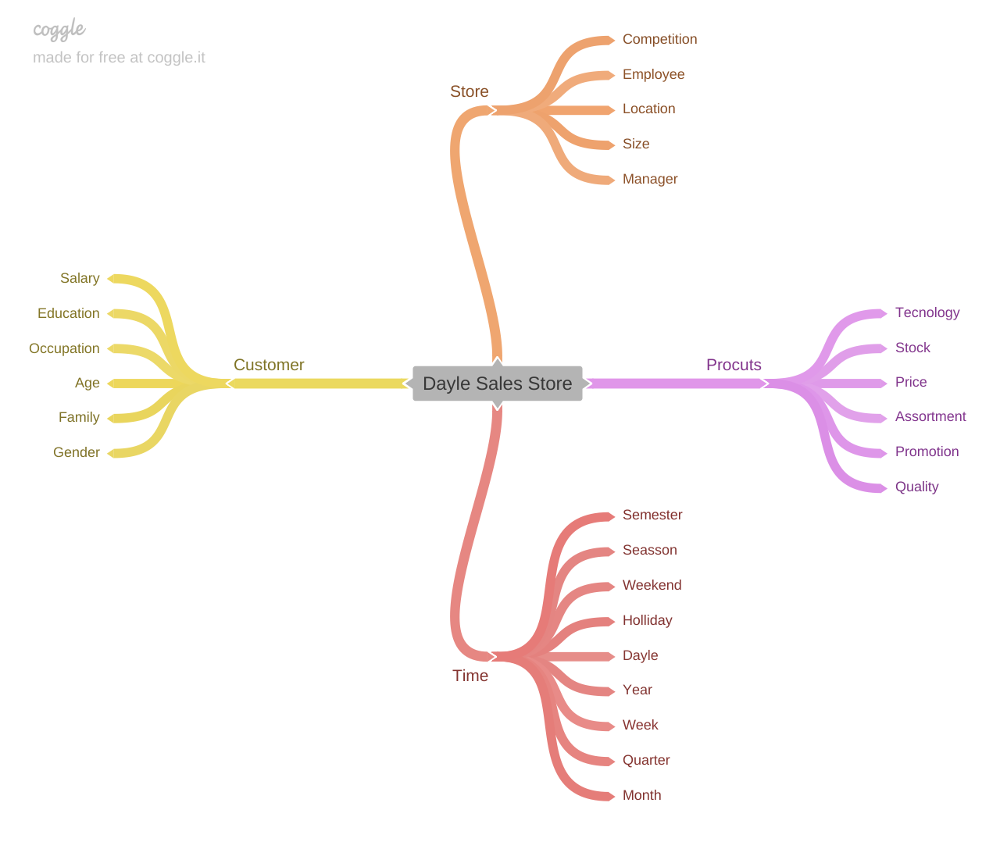

In [40]:
Image('../img/Dayle_Sales_Store.png', height=300)

#### Store Hyphotesis

1. Lojas maiores deveriam vender mais;

2. Lojas com mais funcionários deveriam vender mais;

3. Lojas com concorrentes por perto deveriam vender menos;

4. Lojas com maior estoque deveriam vender mais;

5. Lojas com mais produtos na vitrine deveriam vender mais;

6. Lojas com maior sortimento deveriam vender mais; 

7. Lojas com concorrentes a mais tempo deveriam vender mais;

8. Lojas com promoção ativas deveriam vender mais;

9. Lojas com promoção ativas por mais tempo deveriam vender mais;

10. Lojas com promoção consecutivas deveriam vender mais; 

#### Product Hyphotesis

1. Produtos mais baratos deveriam vender mais;

2. Produtos em promoção deveriam vender mais;

3. Produtos mais caros deveriam vender menos;

4. Produtos com maior qualidade deveriam vender mais;

#### Time Hyphotesis

1. No segundo semestre deveriam aumentar as vendas;

2. No verão as vendas deveriam ser maiores;

3. No final de semana as vendas são menores;

4. Durante as férias escolares as vendas são menores;

5. No natal as vendas são maiores; 

6. As vendas são maiores com o passar dos anos;

### Hypotheses List

1. Stores with a larger assortment sell more

2. Stores with competitors nearby sell less

3. Stores with competitors for longer sell more

4. Stores with active promotion sell more

5. Stores with consecutive promotions sell more

6. At Christmas sales are higher

7. Sales are higher over the years

8. In the second half of the year, sales increase

9. On weekend sales are lower

10. During school holidays sales are lower

11. After the 10th of each month more sales are higher

### Feature Engineering

#### CRISP 1

In [ ]:
#------------------------------------------------Time Features------------------------------------------
# year
df1['year'] = df1['date'].dt.year

# month
df1['month'] = df1['date'].dt.month

# day
df1['day'] = df1['date'].dt.day

# week of year
df1['week_of_year'] = df1['date'].dt.isocalendar().week

# year week
df1['year_week'] = df1['date'].dt.strftime('%Y-%W')

# competition since - year and month
df1['competition_since'] = df1.apply(lambda x: datetime(year=x['competition_open_since_year'], month=x['competition_open_since_month'], day=1), axis=1)

# Number of months of competition
df1['competition_time_month'] = ((df1['date'] - df1['competition_since']) / 30).apply(lambda x: x.days).astype(int)

# promo since - date of started promotion
df1['promo_since'] = df1['promo2_since_year'].astype(str) + '-' + df1['promo2_since_week'].astype(str)
df1['promo_since'] = df1['promo_since'].apply(lambda x: datetime.strptime(x + '-1', '%Y-%W-%w') - timedelta(days=7))

# promo_time_week - number of weeks of promotion
df1['promo_time_week'] = ((df1['date'] - df1['promo_since']) / 7).apply(lambda x: x.days).astype(int)

#--------------------------------------------------Readability-------------------------------------------
# Assortment - readable format
df1['assortment'] = df1['assortment'].apply(lambda x: 'basic' if x == 'a' else 'extra' if x == 'b'else 'extended')

# state holiday - readable format
df1['state_holiday'] = df1['state_holiday'].apply(lambda x: 'public_holiday' if x == 'a' else 'easter_holiday' if x == 'b' else 'christmas' if x == 'c' else 'regular_day')

#### CRISP 2

In [53]:
feature_engineering(df1_c2)


        ----------------------------------------------------------
        Columns created:
        
        year
        month
        day
        week_of_year
        year_week
        competition_since
        competition_time_month
        
        ----------------------------------------------------------
        Improves readability 
        
        assortment
        state_holiday
        
        ----------------------------------------------------------
        New features have been created in DataFrame
        


### Feature Summary

In [54]:
print('CRISP 1')
tab = [
    ['Feature', 'Description'],
    ['Year', 'The year of sales'],
    ['Month', 'The month of sales'],
    ['Day', 'The day of sales'],
    ['Week of year', 'The number of week of the year'],
    ['Year/week', 'The year and the number of week'],
    ['Competiton since', 'The month and year of the competition starts'],
    ['Competition month', 'Number of months of competition'],
    ['Promo since', 'Promotion start date'],
    ['Promo time week', 'Number of weeks the promotion started']
]

print(tabulate(tab, headers='firstrow'))

CRISP 1
Feature            Description
-----------------  --------------------------------------------
Year               The year of sales
Month              The month of sales
Day                The day of sales
Week of year       The number of week of the year
Year/week          The year and the number of week
Competiton since   The month and year of the competition starts
Competition month  Number of months of competition
Promo since        Promotion start date
Promo time week    Number of weeks the promotion started


In [55]:
print('CRISP 2')
tab = [
    ['Feature', 'Description'],
    ['Year', 'The year of sales'],
    ['Month', 'The month of sales'],
    ['Day', 'The day of sales'],
    ['Week of year', 'The number of week of the year'],
    ['Year/week', 'The year and the number of week'],
    ['Competiton since', 'The month and year of the competition starts'],
    ['Competition month', 'Number of months of competition'],
]

print(tabulate(tab, headers='firstrow'))

CRISP 2
Feature            Description
-----------------  --------------------------------------------
Year               The year of sales
Month              The month of sales
Day                The day of sales
Week of year       The number of week of the year
Year/week          The year and the number of week
Competiton since   The month and year of the competition starts
Competition month  Number of months of competition


## Data Filter

### Row Filter

In [ ]:
# CRISP 1
# Excludes days that stores were closed and days of sales equal to zero
df1 = df1[(df1['open'] != 0) & (df1['sales'] > 0)]

In [56]:
# CRISP 2
# Excludes days that stores were closed and days of sales equal to zero
df1_c2 = df1_c2[(df1_c2['open'] != 0) & (df1_c2['sales'] > 0)]

### Columns Filter

<b>Motives</b>

customers - Highly correlated with sales, require another model for forecasting

open - Only days with open equal to 1

promo_interval - Auxiliar column

month_map - Auxiliar column

In [ ]:
# CRISP 1
df1.drop(['customers', 'open', 'promo_interval', 'month_map'], axis=1, inplace=True)

In [57]:
# CRISP 2
df1_c2.drop(['customers', 'open', 'promo_interval', 'month_map'], axis=1, inplace=True)

## Output

File with all changes made in this step

In [ ]:
# CRISP 1
#df1.to_csv('../data/processing/transformations.csv', index=False)

In [58]:
# CRISP 2
df1_c2.to_csv('../data/processing/transformations_c2.csv', index=False)

# Exploratory Data Analysis

## Input

Previous step file

In [76]:
# CRISP 1
df2 = pd.read_csv('../data/processing/df1.csv')

In [61]:
# CRISP 2
df2_c2 = pd.read_csv('../data/processing/transformations_c2.csv')

## Univariate Analysis

### Response Variable

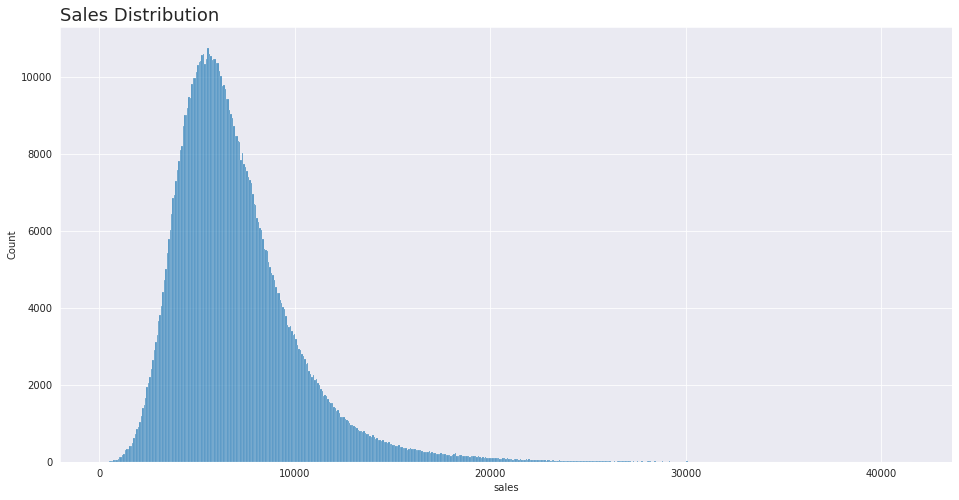

In [30]:
sns.histplot(df2['sales'])
plt.title('Sales Distribution', loc='left', fontsize=18);

In [8]:
fig = px.histogram(df2, x='sales', title='Sales Distribution<br><sup>2013 - 07/2015</sup>')
fig.add_vline(x=df2['sales'].mean(), line_width=3, line_dash='dash', line_color='green', annotation_text='Mean')
fig.update_layout(xaxis_title='$', yaxis_title='Dayle Frequency')
fig.show()

In [26]:
alert('Require transformation to modeling')

💡 Require transformation to modeling


### Numerical Variable

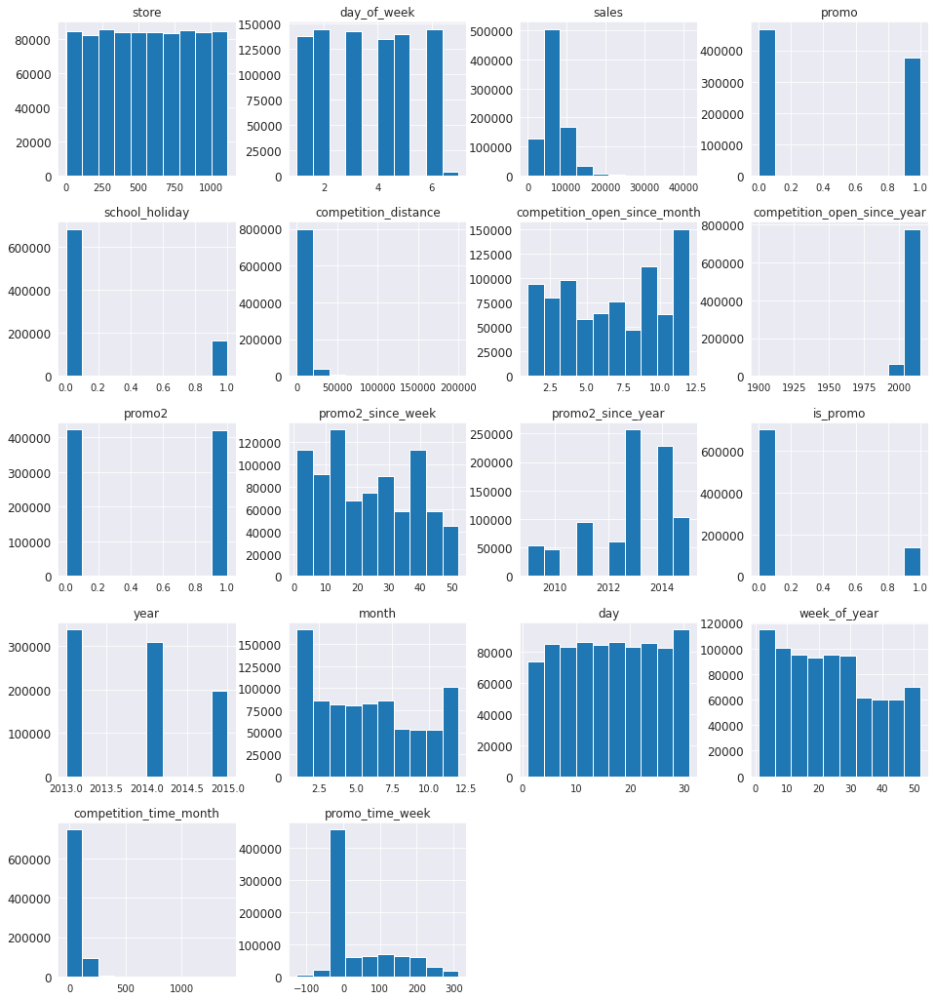

In [39]:
print('CRISP 1')
df2.select_dtypes(include=['int64', 'float64']).hist(figsize=(16, 18), xlabelsize=10, ylabelsize=12);

CRISP 2


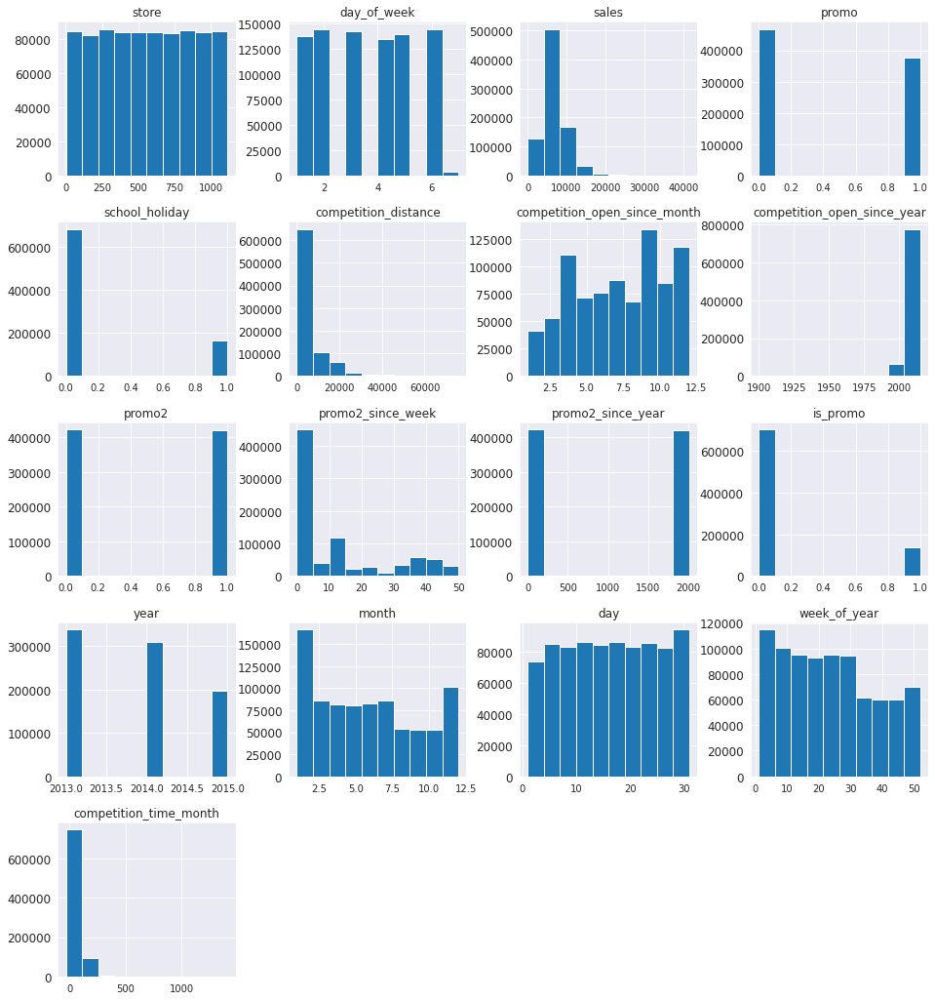

In [62]:
print('CRISP 2')
df2_c2.select_dtypes(include=['int64', 'float64']).hist(figsize=(16, 18), xlabelsize=10, ylabelsize=12);

<font size=4.5><b>store:</b> Frequecy balanced</font>

<font size=4.5><b>day_of_week:</b> Close on weekend</font>

<font size=4.5><b>promo:</b> Approximately balanced, with more days without promotion as expected</font>

<font size=4.5><b>school_holiday:</b> Much more sales outside of school holidays as expected</font>

<font size=4.5><b>competition_open_since_year:</b> Around 2000s</font>

<font size=4.5><b>competition_distance:</b> Usually short distances</font>

<font size=4.5><b>year:</b> 2013 to 2015</font>

### Categorical Variable

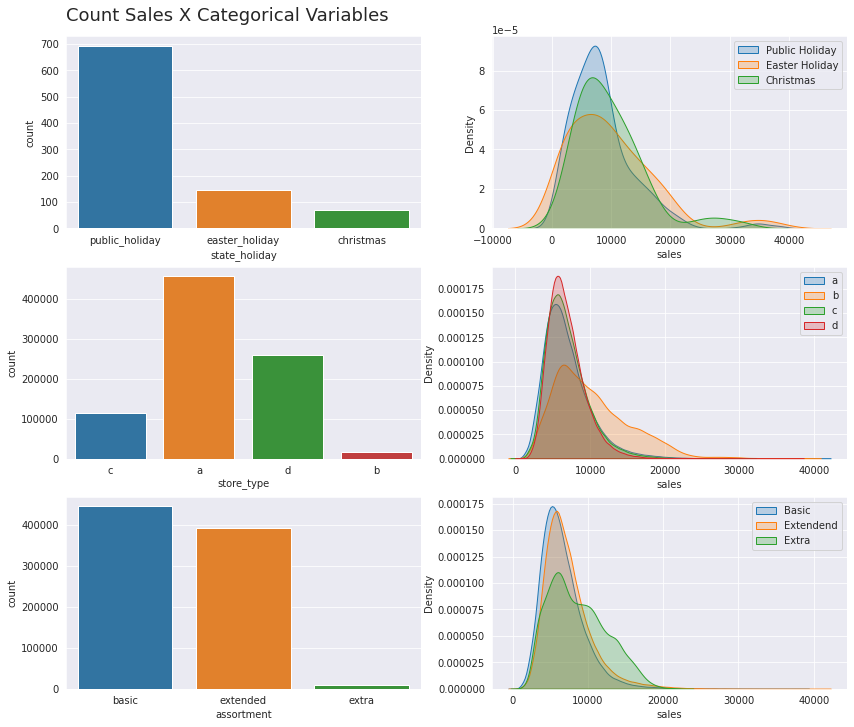

In [27]:
# state_holiday
plt.figure(figsize=(14, 12))
plt.subplot(3, 2, 1)
sns.countplot(x='state_holiday', data=df2[df2 != 'regular_day'])
graph_info('Count Sales X Categorical Variables')

plt.subplot(3, 2, 2)
sns.kdeplot(data=df2[df2['state_holiday'] == 'public_holiday']['sales'], shade=True, label='Public Holiday')
sns.kdeplot(data=df2[df2['state_holiday'] == 'easter_holiday']['sales'], shade=True, label='Easter Holiday')
sns.kdeplot(data=df2[df2['state_holiday'] == 'christmas']['sales'], shade=True, label='Christmas')
plt.legend()

# store_type
plt.subplot(3, 2, 3)
sns.countplot(x='store_type', data=df2)

plt.subplot(3, 2, 4)
sns.kdeplot(data=df2[df2['store_type'] == 'a']['sales'], shade=True, label='a')
sns.kdeplot(data=df2[df2['store_type'] == 'b']['sales'], shade=True, label='b')
sns.kdeplot(data=df2[df2['store_type'] == 'c']['sales'], shade=True, label='c')
sns.kdeplot(data=df2[df2['store_type'] == 'd']['sales'], shade=True, label='d')
plt.legend()

#assortment
plt.subplot(3, 2, 5)
sns.countplot(x='assortment', data=df2)

plt.subplot(3, 2, 6)
sns.kdeplot(data=df2[df2['assortment'] == 'basic']['sales'], shade=True, label='Basic')
sns.kdeplot(data=df2[df2['assortment'] == 'extended']['sales'], shade=True, label='Extendend')
sns.kdeplot(data=df2[df2['assortment'] == 'extra']['sales'], shade=True, label='Extra')
plt.legend();

In [29]:
alert('Categories are unbalanced!')

💡 Categories are unbalanced!


## Bivariate Analysis

### Result of hypotheses

In [25]:
tab = [
    ['hypotheses', 'Description', 'Conclusion', 'Relevance'],
    ['H1', 'Stores with a larger assortment sell more', 'True', 'High'],
    ['H2', 'Stores with competition nearby sell less', 'False', 'Low'],
    ['H3', 'Stores with competitors for longer sell more', 'False', 'Low'],
    ['H4', 'Stores with active promotion sell more', 'True', 'Medium'],
    ['H5', 'Stores with consecutive promotion sell more', 'False', 'High'],
    ['H6', 'At Christmas sales are higher', 'True', 'High'],
    ['H7', 'Sales are higher over the years', 'False', 'High'],
    ['H8', 'In the second half of the years sales increase', 'True', 'Low'],
    ['H9', 'On weekend sales are lower', 'True', 'Low'],
    ['H10', 'During school holidays sales are lower', 'False', 'High'],
    ['H11', 'After the 10th of each month sales are higher', 'False', 'Low']
]

print(tabulate(tab, headers='firstrow'))

hypotheses    Description                                     Conclusion    Relevance
------------  ----------------------------------------------  ------------  -----------
H1            Stores with a larger assortment sell more       True          High
H2            Stores with competition nearby sell less        False         Low
H3            Stores with competitors for longer sell more    False         Low
H4            Stores with active promotion sell more          True          Medium
H5            Stores with consecutive promotion sell more     False         High
H6            At Christmas sales are higher                   True          High
H7            Sales are higher over the years                 False         High
H8            In the second half of the years sales increase  True          Low
H9            On weekend sales are lower                      True          Low
H10           During school holidays sales are lower          False         High
H11           Afte

### H1 - Stores with a larger assortment sell more
---------------------------------------------------

CRISP C1: *False*

Metric: Amount

---------------------------------------------------

CRISP C2: *True*

Metric: Weighted average

---------------------------------------------------

Extra and extended assortment, on average, sells more

#### CRISP 1

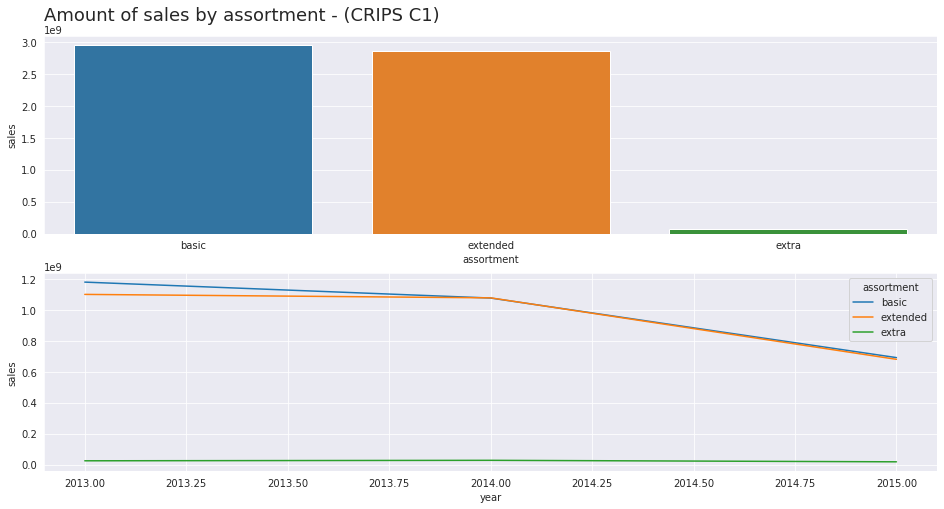

In [58]:
plt.subplot(2, 1, 1)
aux1 = df2[['assortment', 'sales']].groupby('assortment').sum().reset_index()
sns.barplot(x='assortment', y='sales', data=aux1)
graph_info('Amount of sales by assortment - (CRIPS C1)')

plt.subplot(2, 1, 2)
aux2 = df2[['assortment', 'year', 'sales']].groupby(['assortment', 'year']).sum().reset_index()
sns.lineplot(x='year', y='sales', hue='assortment', data=aux2);

In [89]:
aux3 = df2[df2['assortment'] == 'extra'][['year_week', 'sales']].groupby('year_week').sum().reset_index()
px.line(x=aux3['year_week'], y=aux3['sales'], title='Assortment Extra (CRISP C1)')

#### CRISP 2

In [66]:
_ = pd.DataFrame(round(df2_c2['assortment'].value_counts(normalize=True) * 100))
px.pie(_, names=_.index, values='assortment', title='Proportion of store assortment - (CRISP C2)')

In [47]:
alert('The number of stores with assortment equal to extra is much smaller than two others')

💡 The number of stores with assortment equal to extra is much smaller than two others


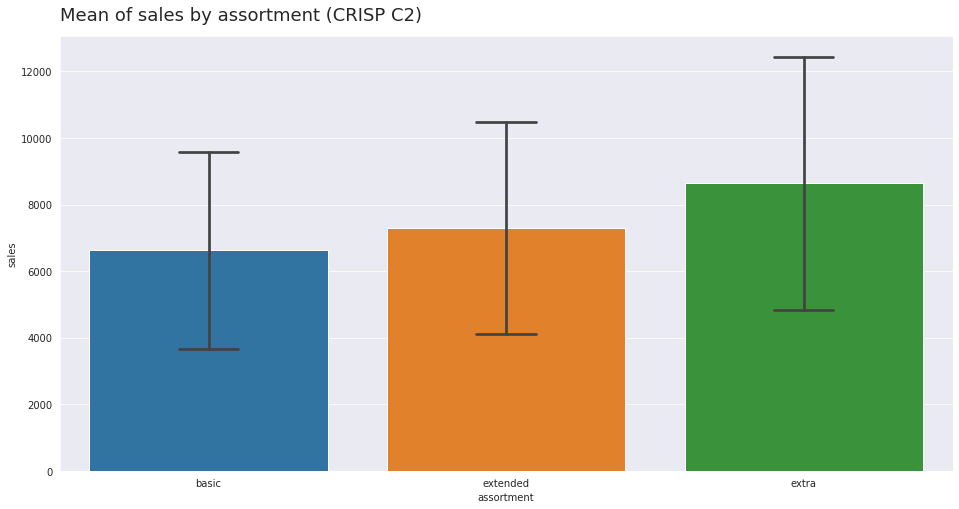

In [63]:
sns.barplot(data=df2_c2, x='assortment', y='sales', estimator=np.average, ci='sd', capsize=.2)
graph_info('Mean of sales by assortment (CRISP C2)')

In [43]:
alert('More stores with extra assortment can increase sales')

💡 More stores with extra assortment can increase sales


### H2 - Stores with competition nearby sell less
---------------------------------------------------

CRISP C1: *False*

Metric: Amount

---------------------------------------------------

CRISP C2: *False*

Metric: Mean

---------------------------------------------------

Stores with a close competitor tend to sell more.

#### CRISP 1

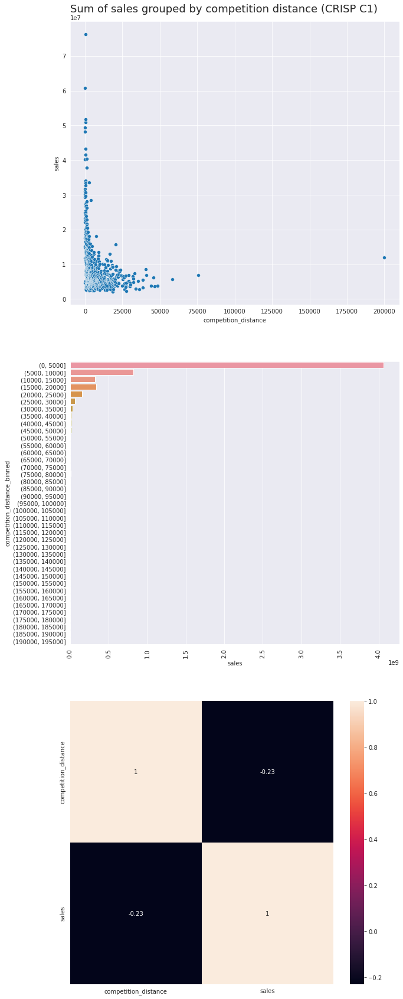

In [68]:
aux1 = df2[['competition_distance', 'sales']].groupby('competition_distance').sum().reset_index()

plt.figure(figsize=(10, 30))
plt.subplot(3, 1, 1)
sns.scatterplot(x='competition_distance', y='sales', data=aux1)
graph_info('Sum of sales grouped by competition distance (CRISP C1)')

bins = np.arange(0, 200000, 5000)
aux1['competition_distance_binned'] = pd.cut(aux1['competition_distance'], bins=bins)
aux2 = aux1[['competition_distance_binned', 'sales']].groupby('competition_distance_binned').sum().reset_index()

plt.subplot(3, 1, 2)
sns.barplot(y='competition_distance_binned', x='sales', data=aux2, orient='h')
plt.xticks(rotation=90)

plt.subplot(3, 1, 3)
sns.heatmap(aux1.corr(), annot=True);

#### CRISP 2

In [68]:
aux1 = df2_c2[['competition_distance', 'sales']].groupby('competition_distance').mean().reset_index()

bins = np.arange(0, 200000, 5000)
aux1['competition_distance_binned'] = pd.cut(aux1['competition_distance'], bins=bins)
aux2 = aux1[['competition_distance_binned', 'sales']].groupby('competition_distance_binned').mean().reset_index()
aux2['limit_interval'] = aux2['competition_distance_binned'].map(attrgetter('right'))

fig = px.line(aux2[:10], x='limit_interval', y='sales', title='Sales average by competition distance (CRISP C2)')
fig.update_layout(xaxis_title='Limit Interval - 5000km')
fig.show()

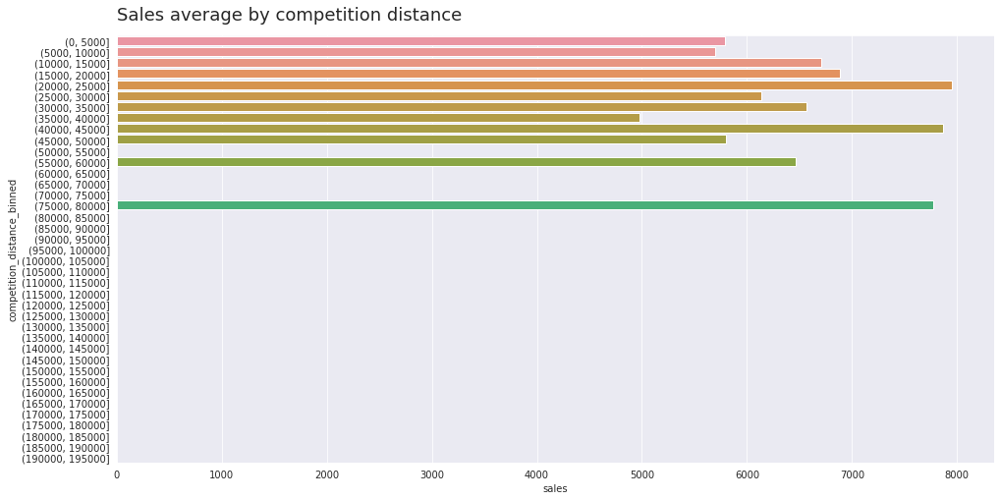

In [69]:
sns.barplot(x='sales', y='competition_distance_binned', data=aux2, orient='h')
graph_info('Sales average by competition distance')

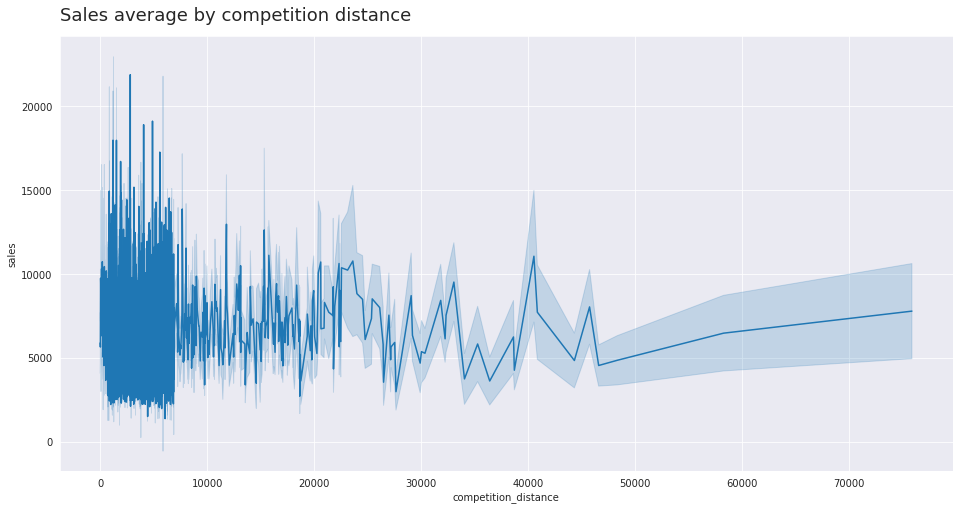

In [70]:
sns.lineplot(x='competition_distance', y='sales', data=df2_c2, 
            estimator='mean', ci='sd')
graph_info('Sales average by competition distance')

In [112]:
alert('Stores tend to be located in strategic locations')

💡 Stores tend to be located in strategic locations


### H3 - Stores with competitors for longer sell more
----------------------------------------
CRISP C1: *False*

Metric: Amount

----------------------------------------

CRISP C2: *False*

Metric: Amount

----------------------------------------

Stores with longer-term competitors sell less

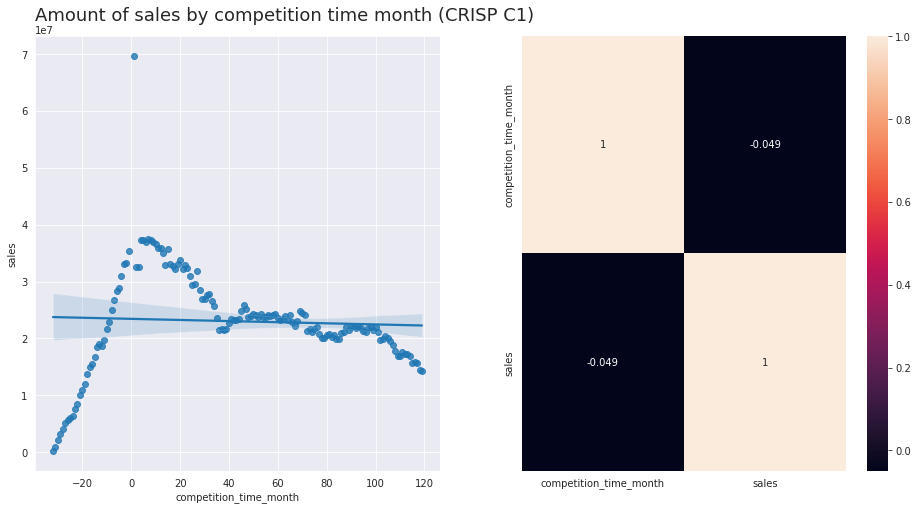

In [65]:
aux1 = df2[['competition_time_month', 'sales']].groupby('competition_time_month').sum().reset_index()
aux1 = aux1[(aux1['competition_time_month'] < 120) & (aux1['competition_time_month'] != 0)]
'''
plt.subplot(1, 3, 1)
sns.barplot(x='competition_time_month', y='sales', data=aux1)
plt.xticks(rotation=90);
'''
plt.subplot(1, 2, 1)
sns.regplot(x='competition_time_month', y='sales', data=aux1)
graph_info('Amount of sales by competition time month (CRISP C1)')

plt.subplot(1, 2, 2)
sns.heatmap(aux1.corr(method='pearson'), annot=True);

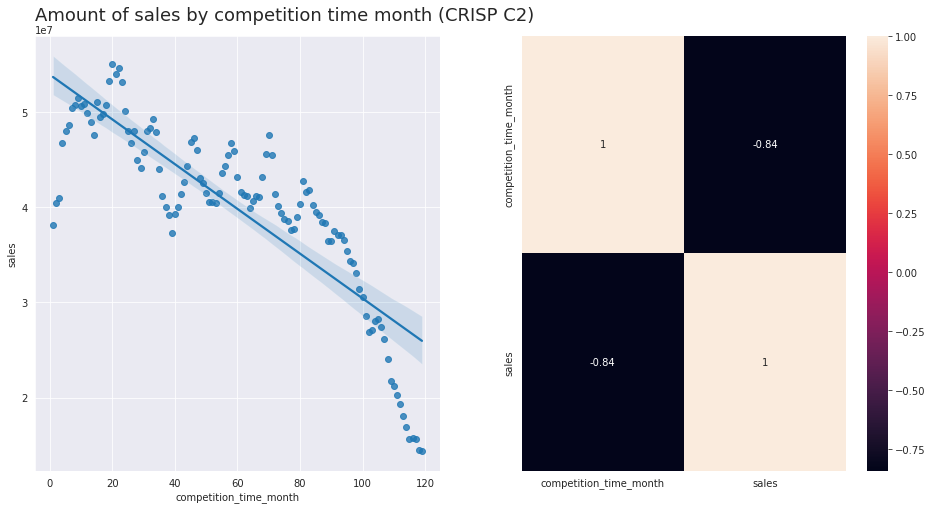

In [73]:
aux1 = df2_c2[['competition_time_month', 'sales']].groupby('competition_time_month').sum().reset_index()
aux1 = aux1[(aux1['competition_time_month'] < 120) & (aux1['competition_time_month'] > 0)]
'''
plt.subplot(1, 3, 1)
sns.barplot(x='competition_time_month', y='sales', data=aux1)
plt.xticks(rotation=90);
'''
plt.subplot(1, 2, 1)
sns.regplot(x='competition_time_month', y='sales', data=aux1)
graph_info('Amount of sales by competition time month (CRISP C2)')

plt.subplot(1, 2, 2)
sns.heatmap(aux1.corr(method='pearson'), annot=True);

### H4 - Stores with active promotion sell more

----------------------------------------------------------

CRISP C1: *False*

Metric: Amount

Longer promotions don't increase the amount of sales over time

----------------------------------------------------------

CRISP C2: *True*

Metric: Mean

Longer promotions increase the average of sales over time

----------------------------------------------------------

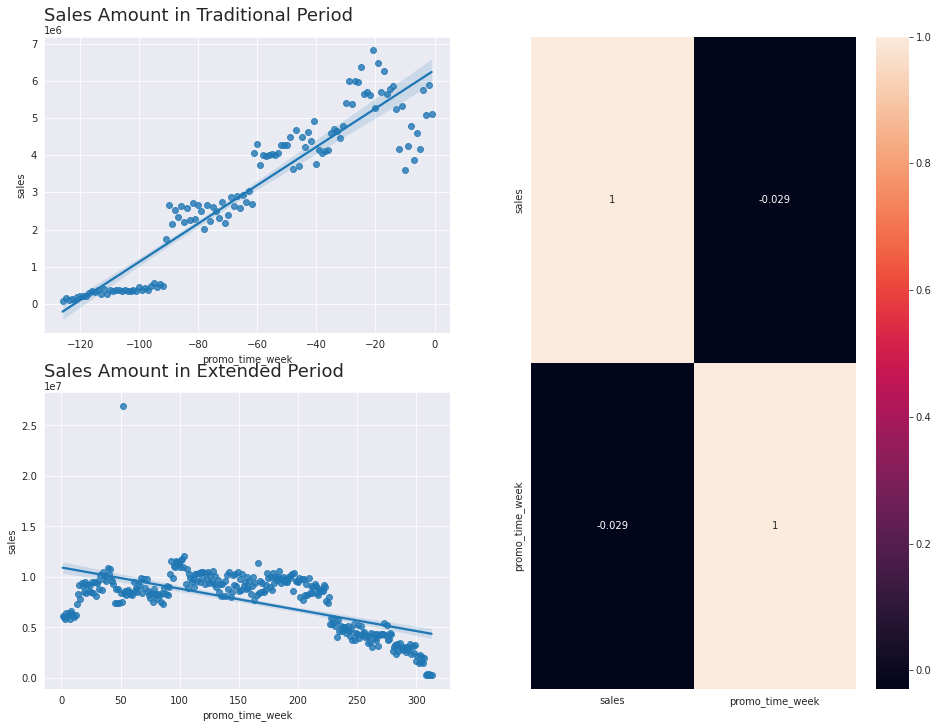

In [102]:
aux1 = df2[['promo_time_week', 'sales']].groupby('promo_time_week').sum().reset_index()

aux2 = aux1[aux1['promo_time_week'] < 0] # Traditional
aux3 = aux1[aux1['promo_time_week'] > 0] # Extended
grid = GridSpec(2, 2)

plt.figure(figsize=(16, 12))
'''
plt.subplot(grid[0,0])
sns.barplot(x='promo_time_week', y='sales', data=aux2)
plt.title('Traditional promotion', fontsize=18)
'''
plt.subplot(grid[0,0])
sns.regplot(x='promo_time_week', y='sales', data=aux2)
graph_info('Sales Amount in Traditional Period')
'''
plt.subplot(grid[1,0])
sns.barplot(x='promo_time_week', y='sales', data=aux3)
plt.title('Extended promotion', fontsize=18)
'''

plt.subplot(grid[1,0])
sns.regplot(x='promo_time_week', y='sales', data=aux3)
graph_info('Sales Amount in Extended Period')

plt.subplot(grid[:, 1])
sns.heatmap(aux1[['sales', 'promo_time_week']].corr(), annot=True);

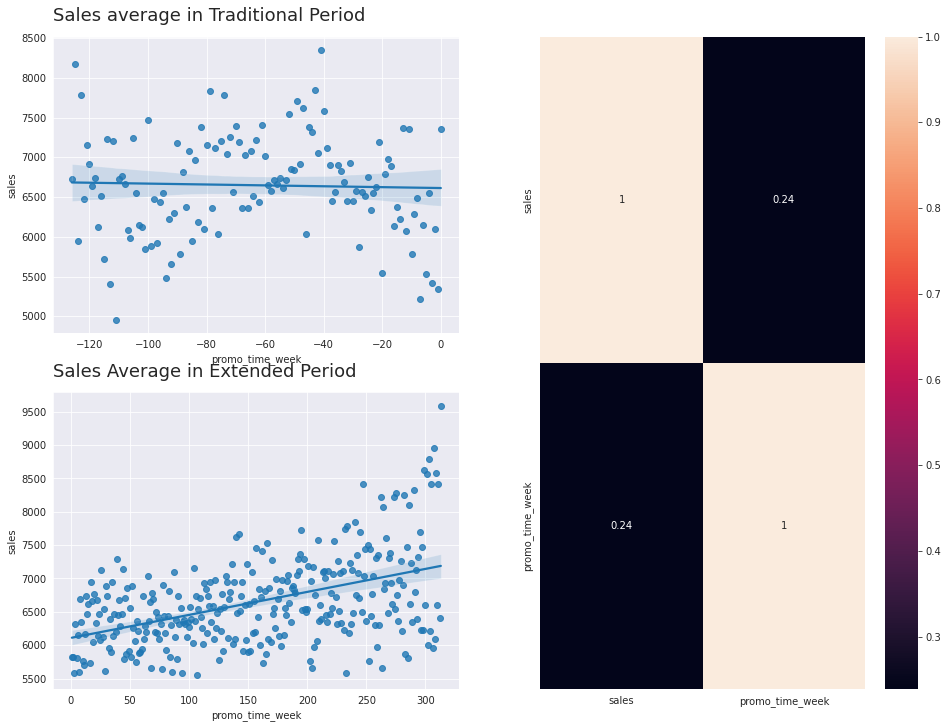

In [77]:
aux1 = df2[['promo_time_week', 'sales']].groupby('promo_time_week').mean().reset_index()

aux2 = aux1[aux1['promo_time_week'] <= 0] # Traditional
aux3 = aux1[aux1['promo_time_week'] > 0] # Extended
grid = GridSpec(2, 2)

plt.figure(figsize=(16, 12))
'''
plt.subplot(grid[0,0])
sns.barplot(x='promo_time_week', y='sales', data=aux2)
plt.title('Traditional promotion', fontsize=18)
'''
plt.subplot(grid[0,0])
sns.regplot(x='promo_time_week', y='sales', data=aux2)
graph_info('Sales average in Traditional Period')
'''
plt.subplot(grid[1,0])
sns.barplot(x='promo_time_week', y='sales', data=aux3)
plt.title('Extended promotion', fontsize=18)
'''

plt.subplot(grid[1,0])
sns.regplot(x='promo_time_week', y='sales', data=aux3)
graph_info('Sales Average in Extended Period')

plt.subplot(grid[:, 1])
sns.heatmap(aux1[['sales', 'promo_time_week']].corr(), annot=True);

In [22]:
print(f"Proportion promotional period: {round(df2[df2['promo_time_week'] > 0]['promo_time_week'].count() * 100 / len(df2))}%")
print(f"Proportion traditional period: {round(df2[df2['promo_time_week'] <= 0]['promo_time_week'].count() * 100 / len(df2))}%")

Proportion promotional period: 43%
Proportion traditional period: 57%


### H5 - Stores with consecutive promotion sell more

---

CRISP C1: *False*

Metric: Amount

Stores with consecutive promotion don't sell more in amount

------

CRISP C2: *False*

Metric: Mean

Stores with consecutive promotion don't sell more in average

------

#### CRISP 1

In [28]:
print('Amount of sales')
df2[['promo', 'promo2', 'sales']].groupby(['promo', 'promo2']).sum().reset_index().sort_values(by='sales', ascending=False)

Amount of sales


,promo,promo2,sales
2,1,0,1628930532
0,0,0,1482612096
3,1,1,1472275754
1,0,1,1289362241


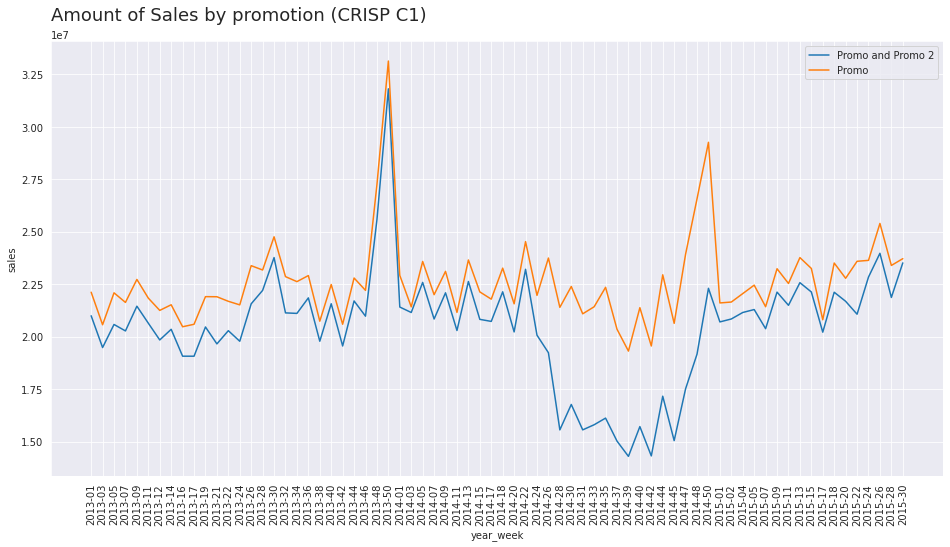

In [26]:
# traditional and extended
aux1 = df2[(df2['promo'] == 1) & (df2['promo2'] == 1)][['year_week', 'sales']].groupby('year_week').sum().reset_index()

sns.lineplot(x='year_week', y='sales', data=aux1, label='Promo and Promo 2')
plt.title('Amount of Sales by promotion (CRISP C1)', loc='left', fontsize=18, pad=20.8)
plt.xticks(rotation=90);

# traditional
aux2 = df2[(df2['promo'] == 1) & (df2['promo2'] == 0)][['year_week', 'sales']].groupby('year_week').sum().reset_index()
sns.lineplot(x='year_week', y='sales', data=aux2, label='Promo')
#plt.title('Traditional X Extendend Promotion', loc='left', fontsize=18, pad=20.8)
plt.xticks(rotation=90)
plt.legend();

#### CRISP 2

In [78]:
print('Proportion of records')
pd.DataFrame(round(df2_c2[['promo', 'promo2']].value_counts(normalize=True) * 100), columns=['%']).reset_index()

Proportion of records


,promo,promo2,%
0,0,0,28.00
1,0,1,28.00
2,1,0,22.00
3,1,1,22.00


More sales were made without any promotion and in promotion 2

In [80]:
print('Average of sales')
aux = df2_c2[['promo', 'promo2', 'sales']].groupby(['promo', 'promo2']).mean().reset_index().sort_values(by='sales', ascending=False)
aux

Average of sales


,promo,promo2,sales
2,1,0,8618.45
3,1,1,7836.67
0,0,0,6328.19
1,0,1,5529.57


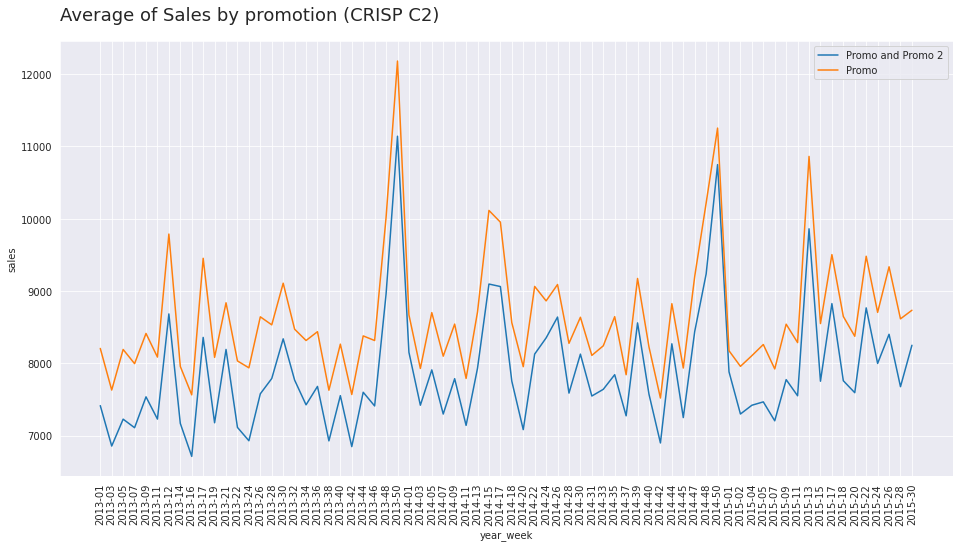

In [81]:
# traditional and extended
aux1 = df2_c2[(df2['promo'] == 1) & (df2['promo2'] == 1)][['year_week', 'sales']].groupby('year_week').mean().reset_index()

sns.lineplot(x='year_week', y='sales', data=aux1, label='Promo and Promo 2')
plt.title('Average of Sales by promotion (CRISP C2)', loc='left', fontsize=18, pad=20.8)
plt.xticks(rotation=90);

# traditional
aux2 = df2[(df2['promo'] == 1) & (df2['promo2'] == 0)][['year_week', 'sales']].groupby('year_week').mean().reset_index()
sns.lineplot(x='year_week', y='sales', data=aux2, label='Promo')
#plt.title('Traditional X Extendend Promotion', loc='left', fontsize=18, pad=20.8)
plt.xticks(rotation=90)
plt.legend();

### H6 - At Christmas sales are higher

-----

CRISP C1: *False*

Metric: Amount

At public holiday sales are higher than christmas

-----

CRISP C2: *True*

Metric: Weighted Mean

At christmas on average sales are higher

-----

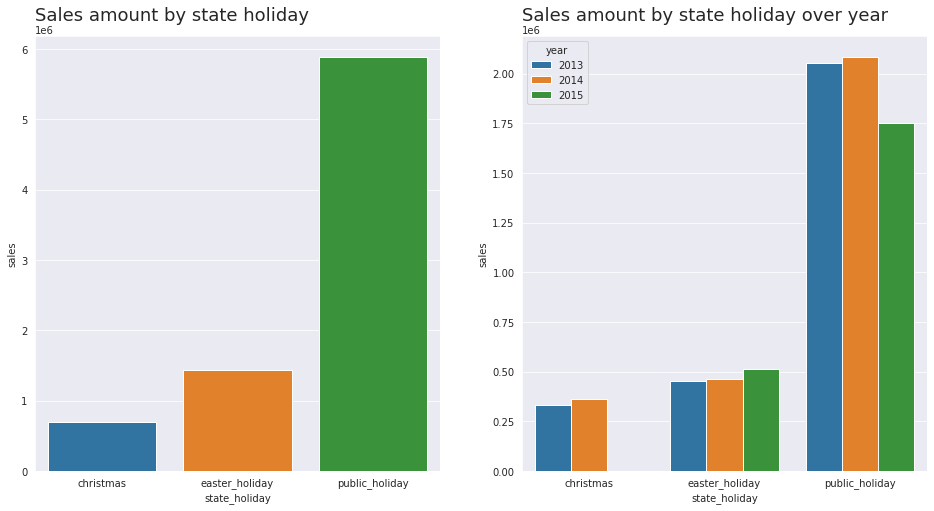

In [31]:
aux = df2[df2['state_holiday'] != 'regular_day']

plt.subplot(1, 2, 1)
aux1 = aux[['state_holiday', 'sales']].groupby('state_holiday').sum().reset_index()
sns.barplot(x='state_holiday', y='sales', data=aux1)
plt.title('Sales amount by state holiday', loc='left', fontsize=18, pad=15.5);

plt.subplot(1, 2, 2)
aux2 = aux[['state_holiday', 'sales', 'year']].groupby(['state_holiday', 'year']).sum().reset_index()
sns.barplot(x='state_holiday', y='sales', hue='year', data=aux2)
plt.title('Sales amount by state holiday over year', loc='left', fontsize=18, pad=15.5);

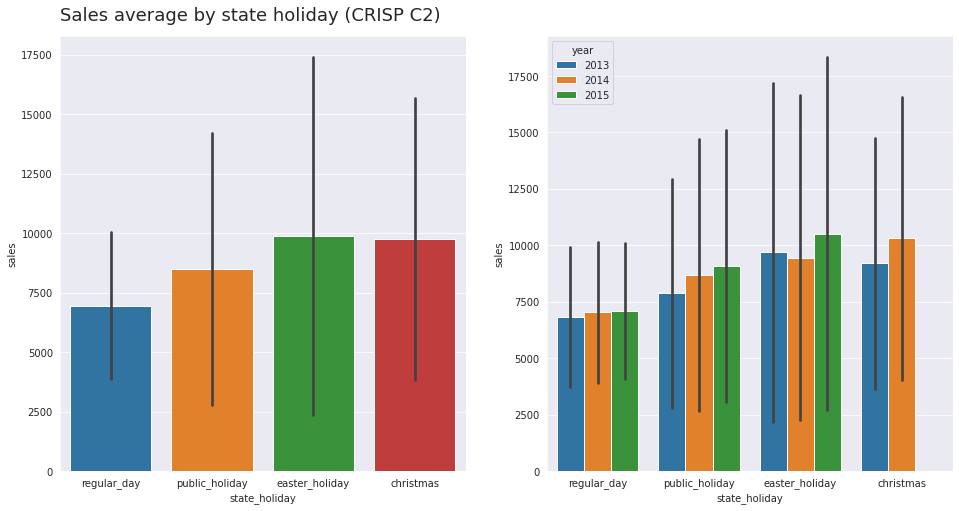

In [82]:
plt.subplot(1, 2, 1)
sns.barplot(x='state_holiday', y='sales', data=df2_c2, estimator=np.average, ci='sd')
graph_info('Sales average by state holiday (CRISP C2)')

plt.subplot(1, 2, 2)
sns.barplot(x='state_holiday', y='sales', data=df2_c2, hue='year', estimator=np.average, ci='sd')
plt.show()

### H7 - Sales are higher over the years

---

CRIPS C1: *False*

Metric: Amount

Sales are lower over the years (include year 2015)

---

CRIPS C2: *False*

Metric: Amount

Sales are lower over the years (exclude year 2015)

---

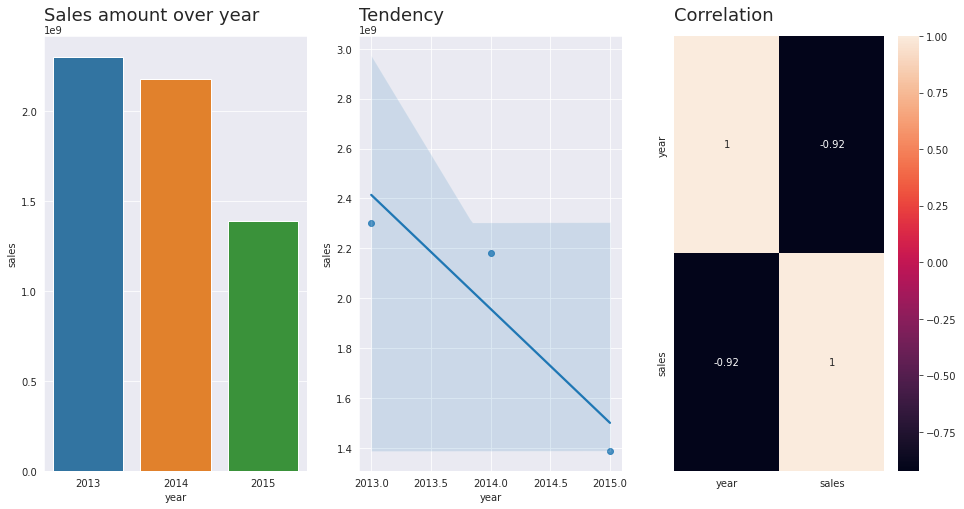

In [69]:
aux1 = df2[['year', 'sales']].groupby('year').sum().reset_index()

plt.subplot(1, 3, 1)
sns.barplot(x='year', y='sales', data=aux1)
plt.title('Sales amount over year', loc='left', fontsize=18, pad=15.5)

plt.subplot(1, 3, 2)
sns.regplot(x='year', y='sales', data=aux1)
graph_info('Tendency')

plt.subplot(1, 3, 3)
sns.heatmap(aux1.corr(), annot=True)
graph_info('Correlation')

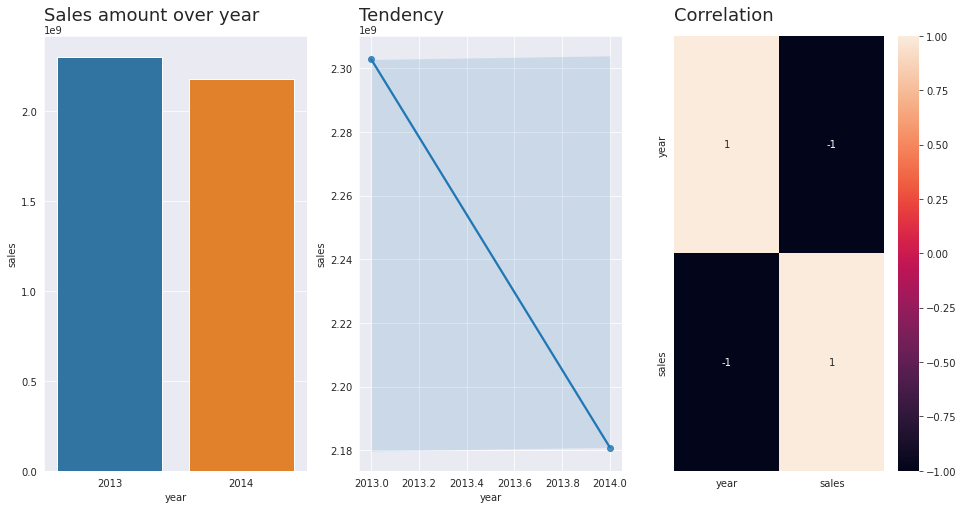

In [83]:
aux1 = df2_c2[['year', 'sales']].groupby('year').sum().reset_index()

plt.subplot(1, 3, 1)
sns.barplot(x='year', y='sales', data=aux1[aux1['year'] != 2015])
plt.title('Sales amount over year', loc='left', fontsize=18, pad=15.5)

plt.subplot(1, 3, 2)
sns.regplot(x='year', y='sales', data=aux1[aux1['year'] != 2015])
graph_info('Tendency')

plt.subplot(1, 3, 3)
sns.heatmap(aux1[aux1['year'] != 2015].corr(), annot=True)
graph_info('Correlation')

Year 2015 is not complet in this dataset

### H8 - In the second half of the years sales increase

---

CRISP C1: *False*

Metric: Amount

Sales decrease in the second half of the years (include year 2015)

---


CRISP C2: *True*

Metric: Amount

Sales decrease in the second half of the years (exclude year 2015)

---

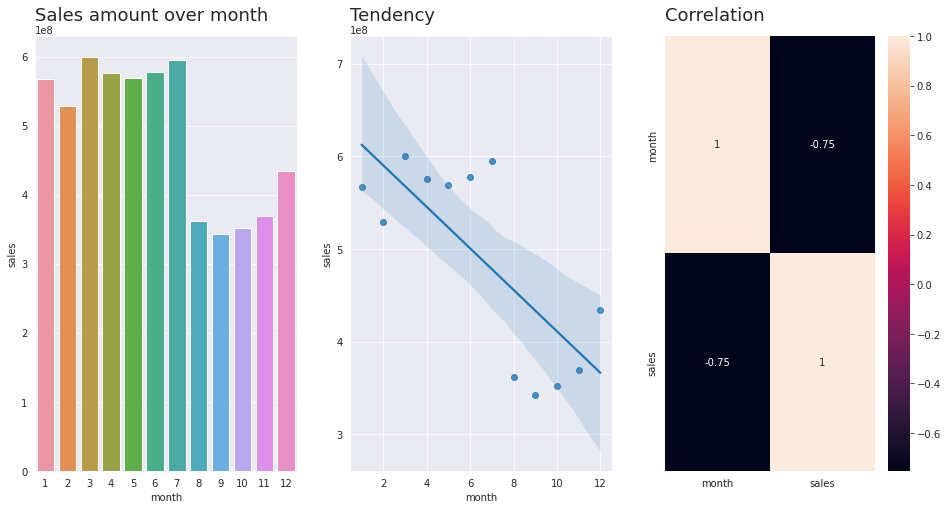

In [68]:
aux1 = df2[['month', 'sales']].groupby('month').sum().reset_index()

plt.subplot(1, 3, 1)
sns.barplot(x='month', y='sales', data=aux1)
graph_info('Sales amount over month')

plt.subplot(1, 3, 2)
sns.regplot(x='month', y='sales', data=aux1)
graph_info('Tendency')

plt.subplot(1, 3, 3)
sns.heatmap(aux1.corr(), annot=True)
graph_info('Correlation')

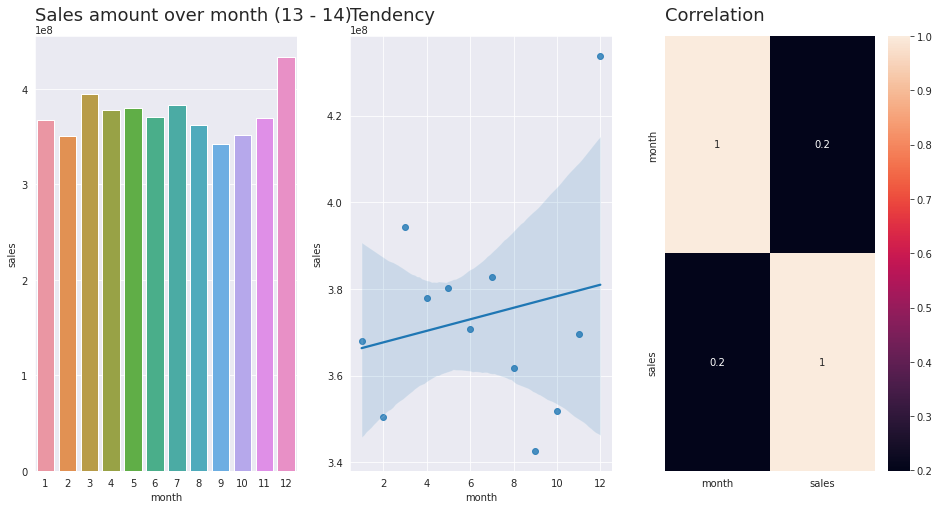

In [84]:
aux1 = df2_c2[df2_c2['year'] < 2015][['month', 'sales']].groupby('month').sum().reset_index()

plt.subplot(1, 3, 1)
sns.barplot(x='month', y='sales', data=aux1)
graph_info('Sales amount over month (13 - 14)')

plt.subplot(1, 3, 2)
sns.regplot(x='month', y='sales', data=aux1)
graph_info('Tendency')

plt.subplot(1, 3, 3)
sns.heatmap(aux1.corr(), annot=True)
graph_info('Correlation')

In [85]:
s1 = df2_c2[df2_c2['year'] < 2015][['month', 'sales']].query('month < 7').groupby('month').sum().sum()[0]
s2 = df2_c2[df2_c2['year'] < 2015][['month', 'sales']].query('month > 6').groupby('month').sum().sum()[0]

print(f'Second half > First half = {s2 > s1}')

Second half > First half = True


### H9 - On weekend sales are lower

---
CRISP C1: *True*

Metric: Amount

---

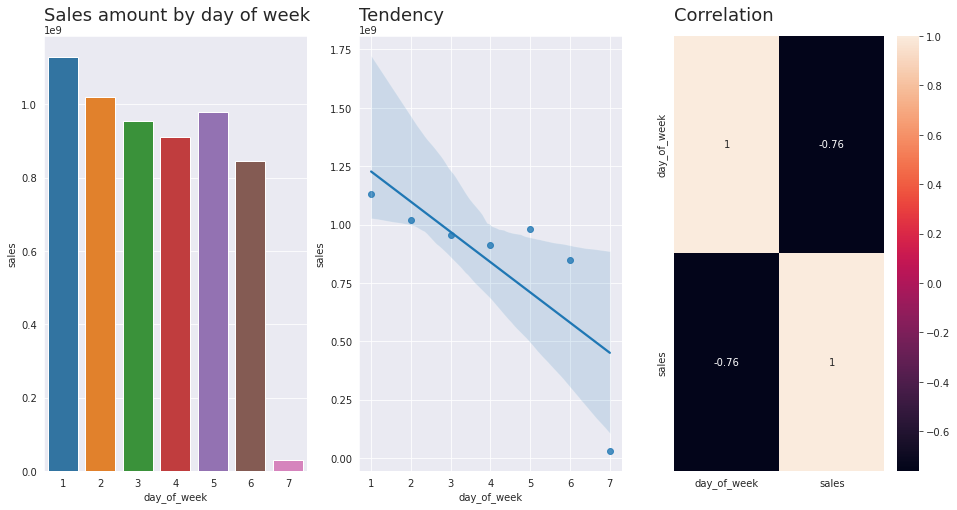

In [71]:
aux1 = df2[['day_of_week', 'sales']].groupby('day_of_week').sum().reset_index()

plt.subplot(1, 3, 1)
sns.barplot(x='day_of_week', y='sales', data=aux1)
plt.title('Sales amount by day of week', loc='left', fontsize=18, pad=15.5)

plt.subplot(1, 3, 2)
sns.regplot(x='day_of_week', y='sales', data=aux1)
graph_info('Tendency')

plt.subplot(1, 3, 3)
sns.heatmap(aux1.corr(), annot=True)
graph_info('Correlation')

### H10 - During school holidays sales are lower

---

CRISP C1: True

Metric: Amount

August is an exception

---

CRISP C2: False

Metric: Weighted mean

December is an exception

---

#### CRISP 1

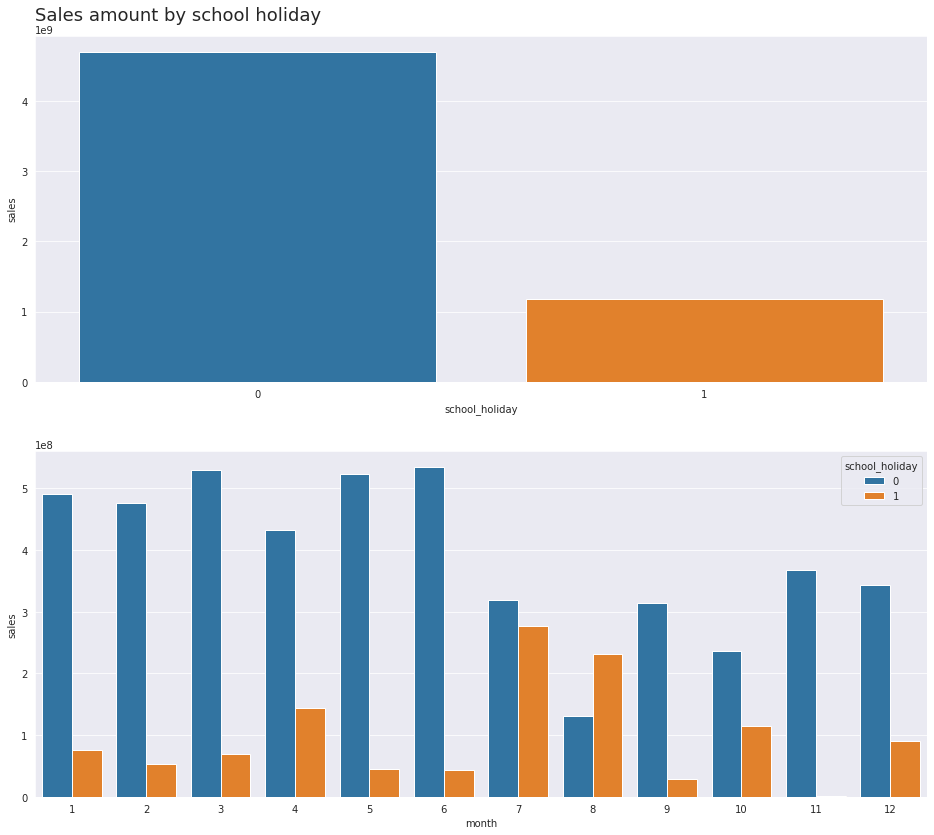

In [75]:
aux1 = df2[['school_holiday', 'sales']].groupby('school_holiday').sum().reset_index()

plt.figure(figsize=(16, 14))
plt.subplot(2, 1, 1)
sns.barplot(x='school_holiday', y='sales', data=aux1)
plt.title('Sales amount by school holiday', loc='left', fontsize=18, pad=15.5)

aux2 = df2[['school_holiday', 'sales', 'month']].groupby(['school_holiday', 'month']).sum().reset_index()
plt.subplot(2, 1, 2)
sns.barplot(x='month', y='sales', hue='school_holiday', data=aux2)
plt.show()

In [84]:
alert('Exception: August')

💡 Exception: August


#### CRISP 2

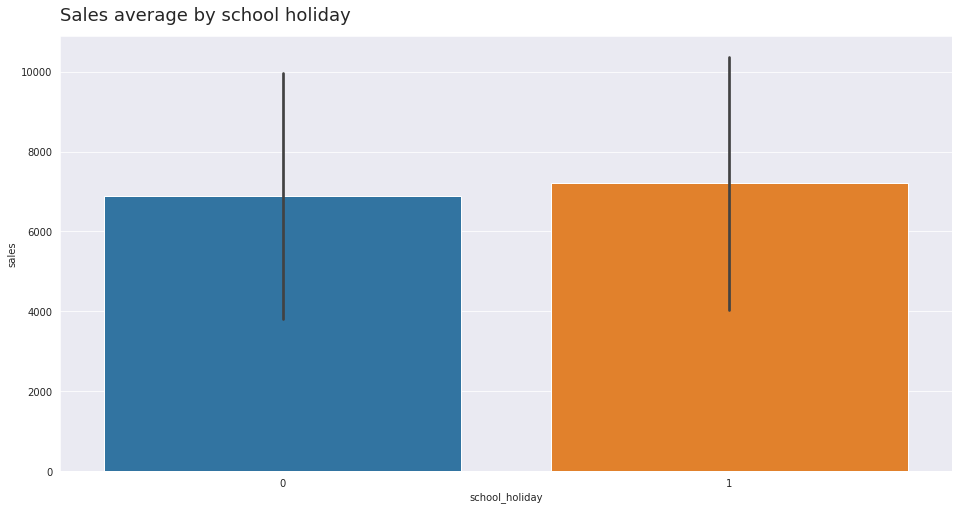

In [86]:
sns.barplot(x='school_holiday', y='sales', data=df2_c2, estimator=np.average, ci='sd')
graph_info('Sales average by school holiday')

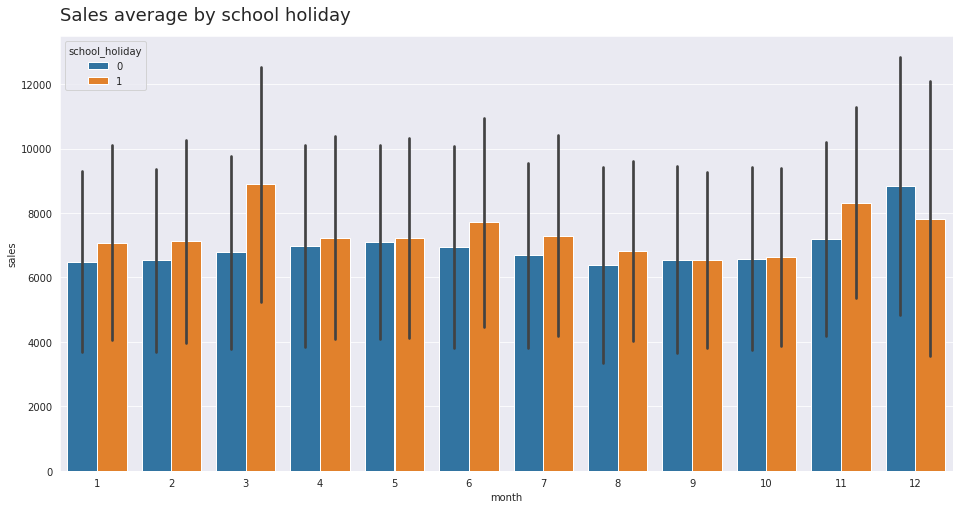

In [87]:
sns.barplot(x='month', y='sales', data=df2_c2, hue='school_holiday', estimator=np.average, ci='sd')
graph_info('Sales average by school holiday')

In [85]:
alert('Exception: December')

💡 Exception: December


### H11 - After the 10th of each month sales are higher

---

CRISP C1: False

Metric: Amount

Ather the 10th the amount tendency is lower

---

CRISP C2: False

Metric: Mean

Ather the 10th the average tendency is lower

---

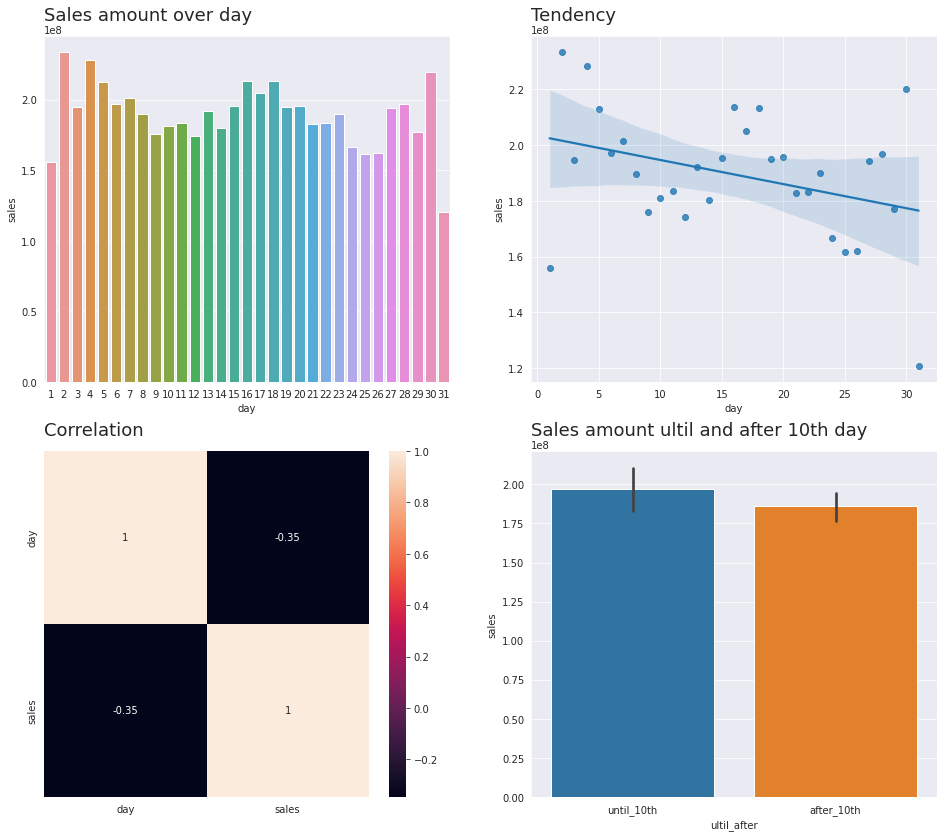

In [7]:
aux1 = df2[['day', 'sales']].groupby('day').sum().reset_index()

plt.figure(figsize=(16, 14))
plt.subplot(2, 2, 1)
sns.barplot(x='day', y='sales', data=aux1)
plt.title('Sales amount over day', loc='left', fontsize=18, pad=15.5)

plt.subplot(2, 2, 2)
sns.regplot(x='day', y='sales', data=aux1)
graph_info('Tendency')

plt.subplot(2, 2, 3)
sns.heatmap(aux1.corr(), annot=True)
graph_info('Correlation')

plt.subplot(2, 2, 4)
aux1['ultil_after'] = aux1['day'].apply(lambda x: 'until_10th' if x <= 10 else 'after_10th')
aux2 = aux1[['ultil_after', 'sales']].groupby('ultil_after').sum().reset_index()
sns.barplot(x='ultil_after', y='sales', data=aux1)
graph_info('Sales amount ultil and after 10th day')

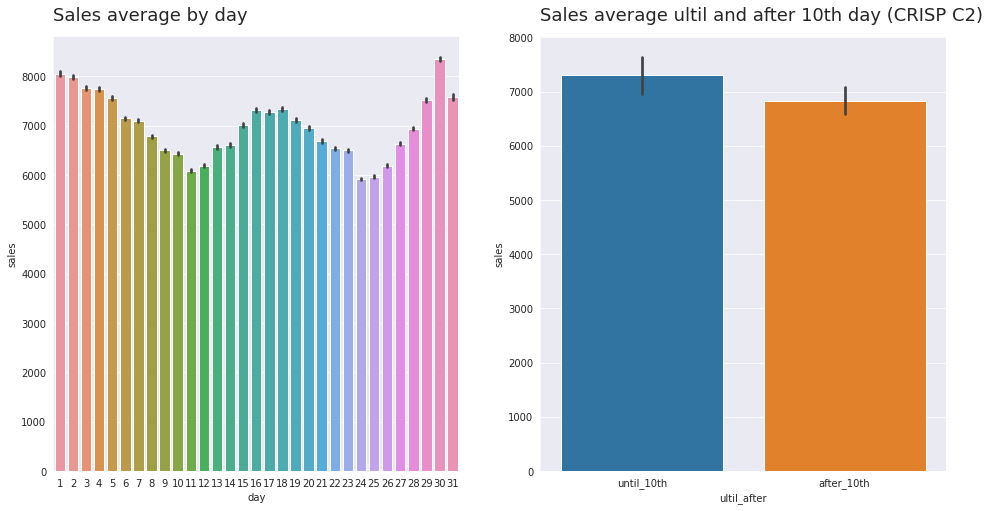

In [88]:
# Auxiliar variable
aux1 = df2_c2[['day', 'sales']].groupby('day').mean().reset_index()
aux1['ultil_after'] = aux1['day'].apply(lambda x: 'until_10th' if x <= 10 else 'after_10th')
aux2 = aux1[['ultil_after', 'sales']].groupby('ultil_after').mean().reset_index()

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
sns.barplot(x='day', y='sales', data=df2)
graph_info('Sales average by day')

plt.subplot(1, 2, 2)
sns.barplot(x='ultil_after', y='sales', data=aux1)
graph_info('Sales average ultil and after 10th day (CRISP C2)')

In [21]:
alert('What are the best days to run promotions (high or low sales days)?')

💡 What are the best days to run promotions (high or low sales days)?


## Multivariate Analysis

### Numerical Variable

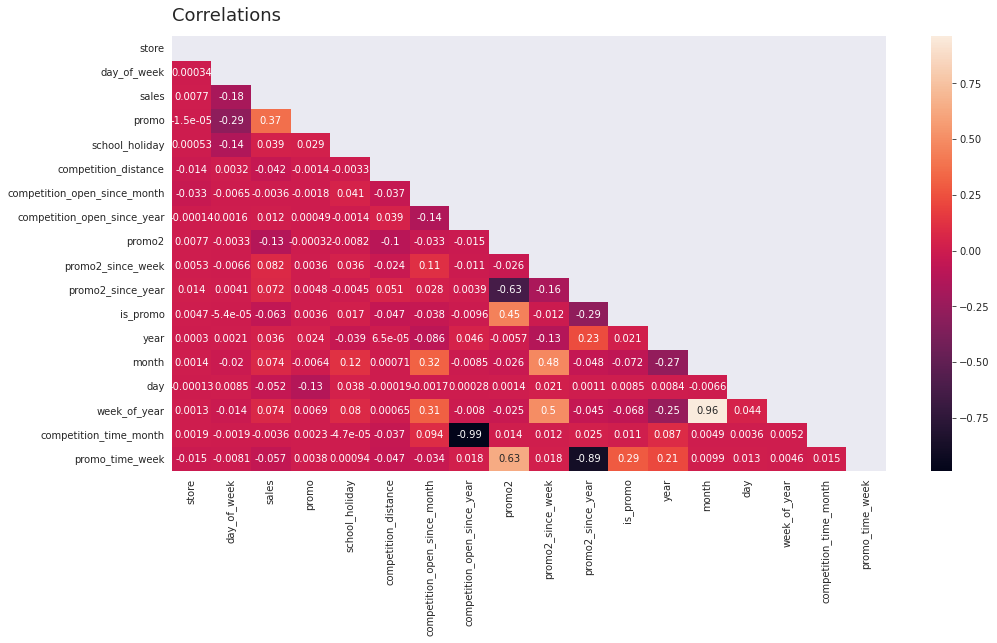

In [26]:
mask = np.zeros_like(df2.select_dtypes(['int64', 'float64']).corr())
mask[np.triu_indices_from(mask)] = True
sns.heatmap(df2.select_dtypes(['int64', 'float64']).corr(), annot=True, mask=mask)
graph_info('Correlations')

In [90]:
print('Dropped columns')
df2_c2[['promo', 'school_holiday', 'promo2', 'is_promo']].sample(2)

Dropped columns


,promo,school_holiday,promo2,is_promo
7454,0,0,0,0
314166,0,0,0,0


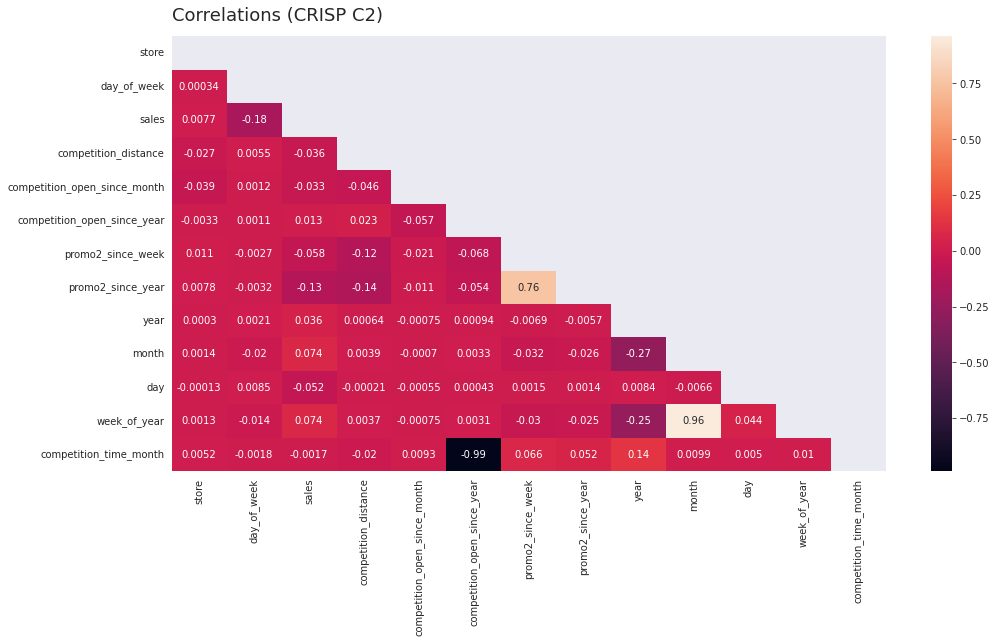

In [91]:
mask = np.zeros_like(df2_c2.select_dtypes(['int64', 'float64']).drop(['promo', 'school_holiday', 'promo2', 
                                                                   'is_promo'], axis=1).corr())
mask[np.triu_indices_from(mask)] = True
sns.heatmap(df2_c2.select_dtypes(['int64', 'float64']).drop(['promo', 'school_holiday', 'promo2', 'is_promo'], 
                                                         axis=1).corr(), annot=True, mask=mask)
graph_info('Correlations (CRISP C2)')

### Categorical Variable

In [45]:
categoricals = df2.select_dtypes(include='object').iloc[:, 1:4]
categoricals.head()

,state_holiday,store_type,assortment
0,regular_day,c,basic
1,regular_day,c,basic
2,regular_day,c,basic
3,regular_day,c,basic
4,regular_day,c,basic


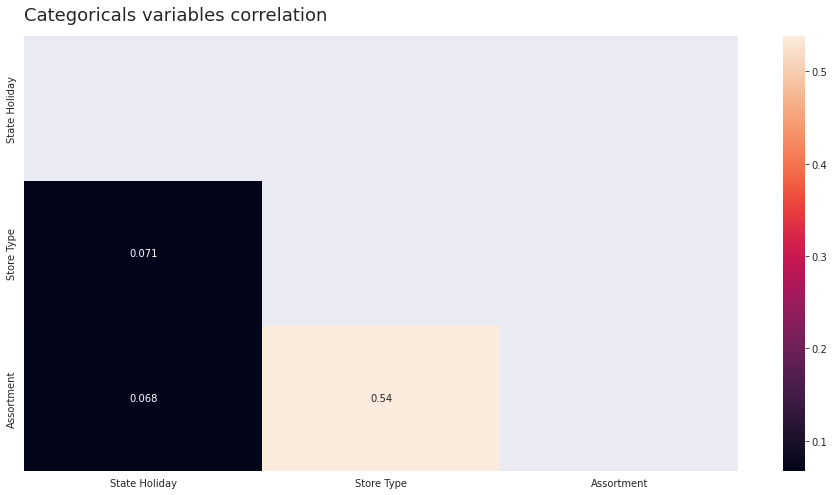

In [47]:
categoricals_1 = cramer_v(categoricals['state_holiday'], categoricals['state_holiday'])
categoricals_2 = cramer_v(categoricals['state_holiday'], categoricals['store_type'])
categoricals_3 = cramer_v(categoricals['state_holiday'], categoricals['assortment'])

categoricals_4 = cramer_v(categoricals['store_type'], categoricals['state_holiday'])
categoricals_5 = cramer_v(categoricals['store_type'], categoricals['store_type'])
categoricals_6 = cramer_v(categoricals['store_type'], categoricals['assortment'])

categoricals_7 = cramer_v(categoricals['assortment'], categoricals['state_holiday'])
categoricals_8 = cramer_v(categoricals['assortment'], categoricals['store_type'])
categoricals_9 = cramer_v(categoricals['assortment'], categoricals['assortment'])

correlations = pd.DataFrame({
    'State Holiday': [categoricals_1, categoricals_2, categoricals_3],
    'Store Type': [categoricals_4, categoricals_5, categoricals_6],
    'Assortment': [categoricals_7, categoricals_8, categoricals_9]
})
correlations = correlations.set_index(correlations.columns)

mask = np.zeros_like(correlations)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(correlations, annot=True, mask=mask)
graph_info('Categoricals variables correlation')

In [92]:
categoricals = df2_c2[['state_holiday', 'store_type', 'assortment', 'promo', 'promo2', 'is_promo', 
                    'school_holiday']]

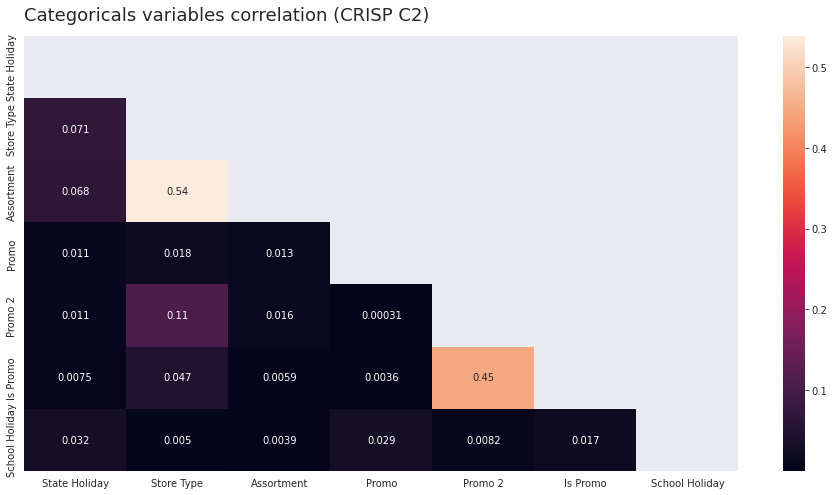

In [93]:
categoricals_1 = cramer_v(categoricals['state_holiday'], categoricals['state_holiday'])
categoricals_2 = cramer_v(categoricals['state_holiday'], categoricals['store_type'])
categoricals_3 = cramer_v(categoricals['state_holiday'], categoricals['assortment'])
categoricals_4 = cramer_v(categoricals['state_holiday'], categoricals['promo'])
categoricals_5 = cramer_v(categoricals['state_holiday'], categoricals['promo2'])
categoricals_6 = cramer_v(categoricals['state_holiday'], categoricals['is_promo'])
categoricals_7 = cramer_v(categoricals['state_holiday'], categoricals['school_holiday'])


categoricals_8 = cramer_v(categoricals['store_type'], categoricals['state_holiday'])
categoricals_9 = cramer_v(categoricals['store_type'], categoricals['store_type'])
categoricals_10 = cramer_v(categoricals['store_type'], categoricals['assortment'])
categoricals_11 = cramer_v(categoricals['store_type'], categoricals['promo'])
categoricals_12 = cramer_v(categoricals['store_type'], categoricals['promo2'])
categoricals_13 = cramer_v(categoricals['store_type'], categoricals['is_promo'])
categoricals_14 = cramer_v(categoricals['store_type'], categoricals['school_holiday'])


categoricals_15 = cramer_v(categoricals['assortment'], categoricals['state_holiday'])
categoricals_16 = cramer_v(categoricals['assortment'], categoricals['store_type'])
categoricals_17 = cramer_v(categoricals['assortment'], categoricals['assortment'])
categoricals_18 = cramer_v(categoricals['assortment'], categoricals['promo'])
categoricals_19 = cramer_v(categoricals['assortment'], categoricals['promo2'])
categoricals_20 = cramer_v(categoricals['assortment'], categoricals['is_promo'])
categoricals_21 = cramer_v(categoricals['assortment'], categoricals['school_holiday'])


categoricals_22 = cramer_v(categoricals['promo'], categoricals['state_holiday'])
categoricals_23 = cramer_v(categoricals['promo'], categoricals['store_type'])
categoricals_24 = cramer_v(categoricals['promo'], categoricals['assortment'])
categoricals_25 = cramer_v(categoricals['promo'], categoricals['promo'])
categoricals_26 = cramer_v(categoricals['promo'], categoricals['promo2'])
categoricals_27 = cramer_v(categoricals['promo'], categoricals['is_promo'])
categoricals_28 = cramer_v(categoricals['promo'], categoricals['school_holiday'])


categoricals_29 = cramer_v(categoricals['promo2'], categoricals['state_holiday'])
categoricals_30 = cramer_v(categoricals['promo2'], categoricals['store_type'])
categoricals_31 = cramer_v(categoricals['promo2'], categoricals['assortment'])
categoricals_32 = cramer_v(categoricals['promo2'], categoricals['promo'])
categoricals_33 = cramer_v(categoricals['promo2'], categoricals['promo2'])
categoricals_34 = cramer_v(categoricals['promo2'], categoricals['is_promo'])
categoricals_35 = cramer_v(categoricals['promo2'], categoricals['school_holiday'])

categoricals_36 = cramer_v(categoricals['is_promo'], categoricals['state_holiday'])
categoricals_37 = cramer_v(categoricals['is_promo'], categoricals['store_type'])
categoricals_38 = cramer_v(categoricals['is_promo'], categoricals['assortment'])
categoricals_39 = cramer_v(categoricals['is_promo'], categoricals['promo'])
categoricals_40 = cramer_v(categoricals['is_promo'], categoricals['promo2'])
categoricals_41 = cramer_v(categoricals['is_promo'], categoricals['is_promo'])
categoricals_42 = cramer_v(categoricals['is_promo'], categoricals['school_holiday'])

categoricals_43 = cramer_v(categoricals['school_holiday'], categoricals['state_holiday'])
categoricals_44 = cramer_v(categoricals['school_holiday'], categoricals['store_type'])
categoricals_45 = cramer_v(categoricals['school_holiday'], categoricals['assortment'])
categoricals_46 = cramer_v(categoricals['school_holiday'], categoricals['promo'])
categoricals_47 = cramer_v(categoricals['school_holiday'], categoricals['promo2'])
categoricals_48 = cramer_v(categoricals['school_holiday'], categoricals['is_promo'])
categoricals_49 = cramer_v(categoricals['school_holiday'], categoricals['school_holiday'])



correlations = pd.DataFrame({
    'State Holiday': [categoricals_1, categoricals_2, categoricals_3, categoricals_4, categoricals_5,
                     categoricals_6, categoricals_7],
    'Store Type': [categoricals_8, categoricals_9, categoricals_10, categoricals_11, categoricals_12,
                  categoricals_13, categoricals_14],
    'Assortment': [categoricals_15, categoricals_16, categoricals_17, categoricals_18, categoricals_19,
                  categoricals_20, categoricals_21],
    'Promo': [categoricals_22, categoricals_23, categoricals_24, categoricals_25, categoricals_26,
             categoricals_27, categoricals_28],
    'Promo 2': [categoricals_29, categoricals_30, categoricals_31, categoricals_32, categoricals_33,
               categoricals_34, categoricals_35],
    'Is Promo': [categoricals_36, categoricals_37, categoricals_38, categoricals_39, categoricals_40,
                categoricals_41, categoricals_42],
    'School Holiday': [categoricals_43, categoricals_44, categoricals_45, categoricals_46, categoricals_47,
                      categoricals_48, categoricals_49]
})
correlations = correlations.set_index(correlations.columns)

mask = np.zeros_like(correlations)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(correlations, annot=True, mask=mask)
graph_info('Categoricals variables correlation (CRISP C2)')

# Data Modeling

CRISP 1 - Without train test split

CRISP 2 - With train test split

## CRISP 1

### Input File

Previous step file

In [58]:
df3 = pd.read_csv('../data/processing/df1.csv')

### Modeling Summary

In [41]:
tab = [
    ['Process', 'Technique', 'Features'],
    ['Rescaling', 'MinMaxScaler(feature_range=(0, 1))', 'promo_time_week, year'],
    ['Rescaling', 'RobustScaler(quantile_range=(25.0, 75.0))', 'competition_distance, competition_time_month'],
    ['Transformation', 'OneHotEncoder', 'state_holiday'],
    ['Transformation', 'LabelEncoder', 'store_type'],
    ['Transformation', 'OrdinalEncoder', 'assortment'],
    ['Transformation', 'Log', 'sales'],
    ['Transformation', 'Nature', 'day_of_week_sin, day_of_week_cos, month_sin'],
    ['Transformation', 'Nature', 'month_cos, day_sin, day_cos'],
    ['Transformation', 'Nature', 'week_of_year_sin, week_of_year_cos']
]

print(tabulate(tab, headers='firstrow'))

Process         Technique                                  Features
--------------  -----------------------------------------  --------------------------------------------
Rescaling       MinMaxScaler(feature_range=(0, 1))         promo_time_week, year
Rescaling       RobustScaler(quantile_range=(25.0, 75.0))  competition_distance, competition_time_month
Transformation  OneHotEncoder                              state_holiday
Transformation  LabelEncoder                               store_type
Transformation  OrdinalEncoder                             assortment
Transformation  Log                                        sales
Transformation  Nature                                     day_of_week_sin, day_of_week_cos, month_sin
Transformation  Nature                                     month_cos, day_sin, day_cos
Transformation  Nature                                     week_of_year_sin, week_of_year_cos


### Normalization

Don't have normal distribution to apply normalization properly.

### Rescaling

In [6]:
mms = MinMaxScaler()
rs = RobustScaler()

# Robust Scaler
# competition_distance
df3['competition_distance'] = rs.fit_transform(df3[['competition_distance']].values)

# competition_time_month
df3['competition_time_month'] = rs.fit_transform(df3[['competition_time_month']].values)

# Min Max Scaler
# promo_time_week
df3['promo_time_week'] = mms.fit_transform(df3[['promo_time_week']].values)

# year
df3['year'] = mms.fit_transform(df3[['year']].values)

# Cyclic
# competition_open_since_month

### Transformation

#### Encoding

In [7]:
# State Holiday - OheHotEncoding
df3 = pd.get_dummies(df3, prefix=['state_holiday'], columns=['state_holiday'])

# Store Type - Label Encoding
le = LabelEncoder()
df3['store_type'] = le.fit_transform(df3['store_type'])

# Assortment - Ordinal encoding
store_type = {'basic': 1, 'extra': 2, 'extended': 3}
df3['assortment'] = df3['assortment'].map(store_type)

#### Response Variable Transformation

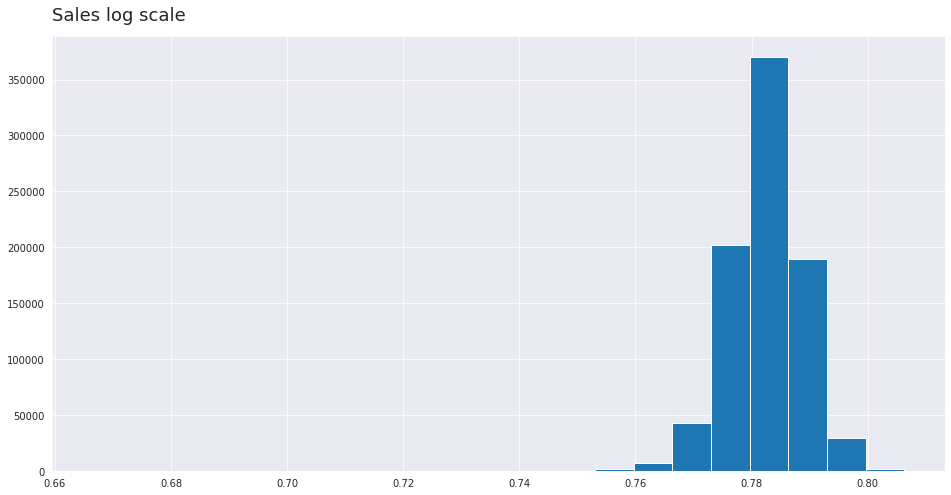

In [62]:
# response variable normalization
df3['sales'] = np.log1p(df3['sales'])
df3['sales'].hist(bins='sturges')
graph_info('Sales log scale')

#### Nature Transformation

In [9]:
# day_of_week
df3['day_of_week_sin'] = df3['day_of_week'].apply(lambda x: np.sin(x * (2 * np.pi / 7)))
df3['day_of_week_cos'] = df3['day_of_week'].apply(lambda x: np.cos(x * (2 * np.pi / 7)))

# month
df3['month_sin'] = df3['month'].apply(lambda x: np.sin(x * (2 * np.pi / 12)))
df3['month_cos'] = df3['month'].apply(lambda x: np.cos(x * (2 * np.pi / 12)))

#day
df3['day_sin'] = df3['day'].apply(lambda x: np.sin(x * (2 * np.pi / 30)))
df3['day_cos'] = df3['day'].apply(lambda x: np.cos(x * (2 * np.pi / 30)))

# week_of_year
df3['week_of_year_sin'] = df3['week_of_year'].apply(lambda x: np.sin(x * (2 * np.pi / 52)))
df3['week_of_year_cos'] = df3['week_of_year'].apply(lambda x: np.cos(x * (2 * np.pi / 52)))

### Output File

In [10]:
# CRISP 1
df3.to_csv('../data/processing/modeling.csv', index=False)

## CRISP 2

### Input File

In [31]:
# CRISP 2
df3_c2 = pd.read_csv('../data/processing/transformations_c2.csv')

### Modeling Summary

In [42]:
tab = [
    ['Process', 'Technique', 'Features'],
    ['Rescaling', 'MinMaxScaler(feature_range=(0, 1))', 'year'],
    ['Rescaling', 'RobustScaler(quantile_range=(25.0, 75.0))', 'competition_distance, competition_time_month'],
    ['Transformation', 'OneHotEncoder', 'state_holiday'],
    ['Transformation', 'LabelEncoder', 'store_type'],
    ['Transformation', 'OrdinalEncoder', 'assortment'],
    ['Transformation', 'Log', 'sales'],
    ['Transformation', 'Nature', 'day_of_week_sin, day_of_week_cos, month_sin'],
    ['Transformation', 'Nature', 'month_cos, day_sin, day_cos'],
    ['Transformation', 'Nature', 'week_of_year_sin, week_of_year_cos']
]

print(tabulate(tab, headers='firstrow'))

Process         Technique                                  Features
--------------  -----------------------------------------  --------------------------------------------
Rescaling       MinMaxScaler(feature_range=(0, 1))         year
Rescaling       RobustScaler(quantile_range=(25.0, 75.0))  competition_distance, competition_time_month
Transformation  OneHotEncoder                              state_holiday
Transformation  LabelEncoder                               store_type
Transformation  OrdinalEncoder                             assortment
Transformation  Log                                        sales
Transformation  Nature                                     day_of_week_sin, day_of_week_cos, month_sin
Transformation  Nature                                     month_cos, day_sin, day_cos
Transformation  Nature                                     week_of_year_sin, week_of_year_cos


### Train test split

In [32]:
# To prevent data leakage
# Training dataset
X_train_c2 = df3_c2[df3_c2['date'] < '2015-06-19']
y_train_c2 = X_train_c2['sales']

# Test dataset
X_test_c2 = df3_c2[df3_c2['date'] >= '2015-06-19']
y_test_c2 = X_test_c2['sales']

print(f'Training min date: {X_train_c2["date"].min()}')
print(f'Training max date: {X_train_c2["date"].max()}')

print(f'\nTest min date: {X_test_c2["date"].min()}')
print(f'Test max date: {X_test_c2["date"].max()}')

Training min date: 2013-01-01
Training max date: 2015-06-18

Test min date: 2015-06-19
Test max date: 2015-07-31


In [108]:
print('Number of weeks to test')
(datetime.strptime(X_test['date'].max(), '%Y-%m-%d') - datetime.strptime(X_test['date'].min(), '%Y-%m-%d')).days / 7

Number of weeks to test


6.0

### Rescaling

In [33]:
mms = MinMaxScaler()
rs = RobustScaler()

# Train
# Robust Scaler
# competition_distance
X_train_c2['competition_distance'] = rs.fit_transform(X_train_c2[['competition_distance']].values)

# competition_time_month
X_train_c2['competition_time_month'] = rs.fit_transform(X_train_c2[['competition_time_month']].values)

# Min Max Scaler
# year
X_train_c2['year'] = mms.fit_transform(X_train_c2[['year']].values)

In [34]:
# Test
# Robust Scaler
# competition_distance
X_test_c2['competition_distance'] = rs.fit_transform(X_test_c2[['competition_distance']].values)

# competition_time_month
X_test_c2['competition_time_month'] = rs.fit_transform(X_test_c2[['competition_time_month']].values)

# Min Max Scaler
# year
X_test_c2['year'] = mms.fit_transform(X_test_c2[['year']].values)

### Transformation

#### Encoding

In [35]:
# Train
# State Holiday - OheHotEncoding
X_train_c2 = pd.get_dummies(X_train_c2, prefix=['state_holiday'], columns=['state_holiday'])

# Store Type - Label Encoding
le = LabelEncoder()
X_train_c2['store_type'] = le.fit_transform(X_train_c2['store_type'])

# Assortment - Ordinal encoding
store_type = {'basic': 1, 'extra': 2, 'extended': 3}
X_train_c2['assortment'] = X_train_c2['assortment'].map(store_type)

In [36]:
# Test
# State Holiday - OheHotEncoding
X_test_c2 = pd.get_dummies(X_test_c2, prefix=['state_holiday'], columns=['state_holiday'])

# Store Type - Label Encoding
X_test_c2['store_type'] = le.fit_transform(X_test_c2['store_type'])

# Assortment - Ordinal encoding
store_type = {'basic': 1, 'extra': 2, 'extended': 3}
X_test_c2['assortment'] = X_test_c2['assortment'].map(store_type)

#### Response Variable Transformation

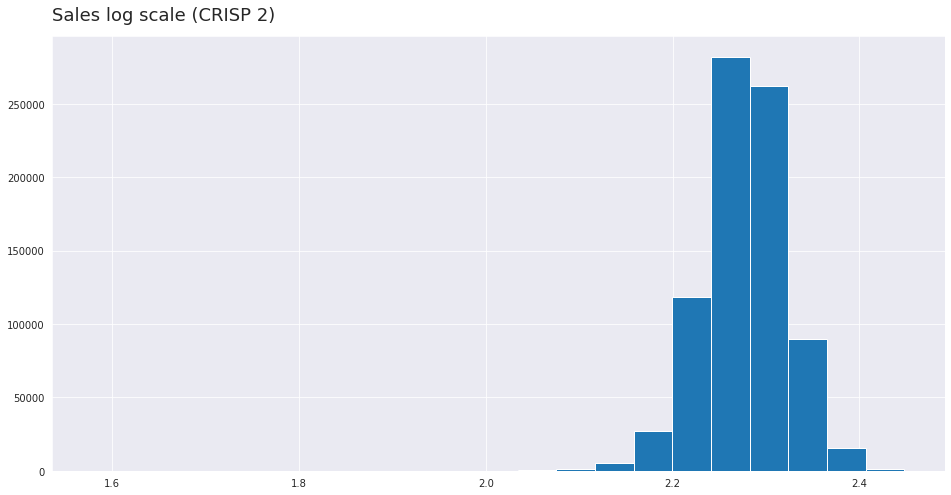

In [39]:
# X train
X_train_c2['sales'] = np.log1p(X_train_c2['sales'])
X_train_c2['sales'].hist(bins='sturges')
graph_info('Sales log scale (CRISP 2)')

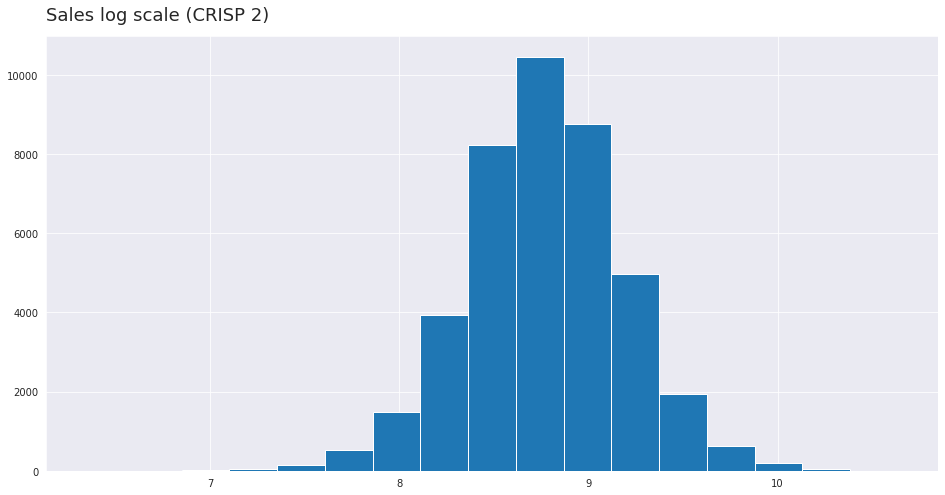

In [40]:
# X test
X_test_c2['sales'] = np.log1p(X_test_c2['sales'])
X_test_c2['sales'].hist(bins='sturges')
graph_info('Sales log scale (CRISP 2)')

In [41]:
# Y train and test
y_train_c2 = pd.DataFrame({'sales': np.log1p(y_train_c2)}).reset_index(drop=True)
y_test_c2 = pd.DataFrame({'sales': np.log1p(y_test_c2)}).reset_index(drop=True)

#### Nature Transformation 

In [42]:
# Train
# day_of_week
X_train_c2['day_of_week_sin'] = X_train_c2['day_of_week'].apply(lambda x: np.sin(x * (2 * np.pi / 7)))
X_train_c2['day_of_week_cos'] = X_train_c2['day_of_week'].apply(lambda x: np.cos(x * (2 * np.pi / 7)))

# month
X_train_c2['month_sin'] = X_train_c2['month'].apply(lambda x: np.sin(x * (2 * np.pi / 12)))
X_train_c2['month_cos'] = X_train_c2['month'].apply(lambda x: np.cos(x * (2 * np.pi / 12)))

#day
X_train_c2['day_sin'] = X_train_c2['day'].apply(lambda x: np.sin(x * (2 * np.pi / 30)))
X_train_c2['day_cos'] = X_train_c2['day'].apply(lambda x: np.cos(x * (2 * np.pi / 30)))

# week_of_year
X_train_c2['week_of_year_sin'] = X_train_c2['week_of_year'].apply(lambda x: np.sin(x * (2 * np.pi / 52)))
X_train_c2['week_of_year_cos'] = X_train_c2['week_of_year'].apply(lambda x: np.cos(x * (2 * np.pi / 52)))

In [43]:
# Test
# day_of_week
X_test_c2['day_of_week_sin'] = X_test_c2['day_of_week'].apply(lambda x: np.sin(x * (2 * np.pi / 7)))
X_test_c2['day_of_week_cos'] = X_test_c2['day_of_week'].apply(lambda x: np.cos(x * (2 * np.pi / 7)))

# month
X_test_c2['month_sin'] = X_test_c2['month'].apply(lambda x: np.sin(x * (2 * np.pi / 12)))
X_test_c2['month_cos'] = X_test_c2['month'].apply(lambda x: np.cos(x * (2 * np.pi / 12)))

#day
X_test_c2['day_sin'] = X_test_c2['day'].apply(lambda x: np.sin(x * (2 * np.pi / 30)))
X_test_c2['day_cos'] = X_test_c2['day'].apply(lambda x: np.cos(x * (2 * np.pi / 30)))

# week_of_year
X_test_c2['week_of_year_sin'] = X_test_c2['week_of_year'].apply(lambda x: np.sin(x * (2 * np.pi / 52)))
X_test_c2['week_of_year_cos'] = X_test_c2['week_of_year'].apply(lambda x: np.cos(x * (2 * np.pi / 52)))

### Output File

In [44]:
X_train_c2.to_csv('../data/crisp_2/processing/X_train_c2.csv', index=False)
X_test_c2.to_csv('../data/crisp_2/processing/X_test.csv', index=False)

y_train_c2.to_csv('../data/crisp_2/processing/y_train_c2.csv', index=False)
y_test_c2.to_csv('../data/crisp_2/processing/y_test.csv', index=False)

# Feature Selection 

CRISP 1 - With train test split

CRISP 2 - Train test split before

## CRISP 1

### Input File

In [100]:
# CRISP 1
df4 = pd.read_csv('../data/processing/modeling.csv')

FileNotFoundError: [Errno 2] No such file or directory: '../data/processing/modeling.csv'

### Train and Test split

In [12]:
drop_cols = ['week_of_year', 'day', 'month', 'day_of_week', 'promo_since', 'competition_since', 'year_week']
df4.drop(drop_cols, axis=1, inplace=True)

In [13]:
# Training dataset
X_train = df4[df4['date'] < '2015-06-19']
y_train = X_train['sales']

# Test dataset
X_test = df4[df4['date'] >= '2015-06-19']
y_test = X_test['sales']

print(f'Training min date: {X_train["date"].min()}')
print(f'Training max date: {X_train["date"].max()}')

print(f'\nTest min date: {X_test["date"].min()}')
print(f'Test max date: {X_test["date"].max()}')

Training min date: 2013-01-01
Training max date: 2015-06-18

Test min date: 2015-06-19
Test max date: 2015-07-31


### Boruta as Feature Selector 

In [14]:
# Training and test dataset for Boruta
X_train_n = X_train.drop(['date', 'sales'], axis=1).values
y_train_n = y_train.values

# Define Random Forest Regressor
rf = RandomForestRegressor(n_jobs=-1)

# Define Boruta
boruta = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=42).fit(X_train_n, y_train_n)

In [15]:
cols_selected = boruta.support_.tolist()

X_train_fs = X_train.drop(['date', 'sales'], axis=1)
cols_selected_boruta = X_train_fs.iloc[:, cols_selected].columns.tolist()

cols_not_selected_boruta = list(np.setdiff1d(X_train_fs.columns, cols_selected_boruta))

### Selected Features Adjusted

In [16]:
cols_selected_boruta = [
 'store',
 'promo',
 'store_type',
 'assortment',
 'competition_distance',
 'competition_open_since_month',
 'competition_open_since_year',
 'promo2',
 'promo2_since_week',
 'promo2_since_year',
 'competition_time_month',
 'promo_time_week',
 'day_of_week_sin',
 'day_of_week_cos',
 'month_cos',
 'day_sin',
 'day_cos',
 'week_of_year_cos'
]

# Columns to add
feat_to_add = ['date', 'sales']
cols_selected_boruta_full = cols_selected_boruta.copy()
cols_selected_boruta_full.extend(feat_to_add)

### Feature Selected Summary

In [38]:
tab = [
    ['Feature', 'Description'],
    ['store', 'Store Id'],
    ['promo', 'Indicates whether a store is running a promo on that day'],
    ['store_type', 'Differentiates between 4 different store models: a, b, c, d'],
    ['assortment', 'Describes an assortment level: a = basic, b = extra, c = extended'],
    ['competition_distance', 'Distance in meters to the nearest competitor store'],
    ['competition_open_since_month', 'Gives the approximate month of the time the nearest competitor was opened'],
    ['competition_open_since_year', 'Gives the approximate year of the time the nearest competitor was opened'],
    ['promo2', 'Is a continuing and consecutive promotion for some stores'],
    ['promo2_since_week', 'Number of week of promo2'],
    ['promo2_since_year', 'Number of year of promo2'],
    ['competition_time_month', 'Number of month of competition'],
    ['promo_time_week', 'Number of weeak of promo'],
    ['day_of_week_sin', 'Day of week sine'],
    ['day_of_week_cos', 'Day of week cosine'],
    ['month_cos', 'Month cosine'],
    ['day_cos', 'Day cosine'],
    ['day_sin', 'Day sine'],
    ['week_of_year_cos', 'Week of year cosine']
]

print(tabulate(tab, headers='firstrow', tablefmt="fancy_grid"))

╒══════════════════════════════╤═══════════════════════════════════════════════════════════════════════════╕
│ Feature                      │ Description                                                               │
╞══════════════════════════════╪═══════════════════════════════════════════════════════════════════════════╡
│ store                        │ Store Id                                                                  │
├──────────────────────────────┼───────────────────────────────────────────────────────────────────────────┤
│ promo                        │ Indicates whether a store is running a promo on that day                  │
├──────────────────────────────┼───────────────────────────────────────────────────────────────────────────┤
│ store_type                   │ Differentiates between 4 different store models: a, b, c, d               │
├──────────────────────────────┼───────────────────────────────────────────────────────────────────────────┤
│ assortment       

### Output File

File with all changes made in this step

In [17]:
# Test file
X_test.to_csv('../data/processing/X_test.csv', index=False)

# Train and test files cols selected boruta
X_train[cols_selected_boruta].to_csv('../data/processing/feature_selection_x_train.csv', index=False)
X_test[cols_selected_boruta].to_csv('../data/processing/feature_selection_x_test.csv', index=False)

y_train.to_csv('../data/processing/y_train.csv', index=False)
y_test.to_csv('../data/processing/y_test.csv', index=False)

# Include sales and date
X_train[cols_selected_boruta_full].to_csv('../data/processing/feature_selection_x_train_full.csv', index=False)

# Columns selected boruta full
pd.Series(cols_selected_boruta_full).to_csv('../data/processing/cols_selected_boruta_full.csv', index=False)
 
# Bitbucket storage (large files)
X_train[cols_selected_boruta].to_csv('/home/marcos/Documents/bitbucket/data-science-producao/data/feature_selection_x_train.csv', index=False)
X_test[cols_selected_boruta].to_csv('/home/marcos/Documents/bitbucket/data-science-producao/data/feature_selection_x_test.csv', index=False)

y_train.to_csv('/home/marcos/Documents/bitbucket/data-science-producao/data/y_train.csv', index=False)
y_test.to_csv('/home/marcos/Documents/bitbucket/data-science-producao/data/y_test.csv', index=False)

# Include sales and date
X_train[cols_selected_boruta_full].to_csv('/home/marcos/Documents/bitbucket/data-science-producao/data/feature_selection_x_train_full.csv', index=False)

## CRISP 2

### Input File

In [12]:
X_train_c2 = pd.read_csv('../data/crisp_2/processing/X_train_c2.csv')
X_test_c2 = pd.read_csv('../data/crisp_2/processing/X_test.csv')

y_train_c2 = pd.read_csv('../data/crisp_2/processing/y_train_c2.csv')
y_test_c2 = pd.read_csv('../data/crisp_2/processing/y_test.csv')

In [ ]:
print('CRISP 2')
tab = [
    ['Feature', 'Description'],
    ['store', 'Store Id'],
    ['promo', 'Indicates whether a store is running a promo on that day'],
    ['store_type', 'Differentiates between 4 different store models: a, b, c, d'],
    ['assortment', 'Describes an assortment level: a = basic, b = extra, c = extended'],
    ['competition_distance', 'Distance in meters to the nearest competitor store'],
    ['competition_open_since_month', 'Gives the approximate month of the time the nearest competitor was opened'],
    ['competition_open_since_year', 'Gives the approximate year of the time the nearest competitor was opened'],
    ['promo2', 'Is a continuing and consecutive promotion for some stores'],
    ['promo2_since_week', 'Number of week of promo2'],
    ['promo2_since_year', 'Number of year of promo2'],
    ['competition_time_month', 'Number of month of competition'],
    ['promo_time_week', 'Number of weeak of promo'],
    ['day_of_week_sin', 'Day of week sine'],
    ['day_of_week_cos', 'Day of week cosine'],
    ['month_cos', 'Month cosine'],
    ['day_cos', 'Day cosine'],
    ['day_sin', 'Day sine'],
    ['week_of_year_cos', 'Week of year cosine']
]

print(tabulate(tab, headers='firstrow', tablefmt="fancy_grid"))

### Boruta as Feature Selector

In [16]:
# Drop date columns
drop_cols = ['week_of_year', 'day', 'month', 'day_of_week', 'competition_since', 'year_week']
X_train_c2.drop(columns=drop_cols, inplace=True)
X_test_c2.drop(columns=drop_cols, inplace=True)

# Training and test dataset for Boruta
X_train_n = X_train_c2.drop(columns=['sales', 'date']).values
y_train_n = y_train_c2.values.ravel()

In [7]:
# Define Random Forest Regressor
rf = RandomForestRegressor(n_jobs=-1)

# Define Boruta
boruta = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=42).fit(X_train_c2, y_train_c2)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	26
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	26
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	26
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	26
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	26
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	26
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	26
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	16
Tentative: 	0
Rejected: 	10


BorutaPy finished running.

Iteration: 	9 / 100
Confirmed: 	16
Tentative: 	0
Rejected: 	10


### Features Selected Adjusted

In [35]:
# Columns selected | True or False
cols_selected = boruta.support_.tolist()

# Original columns
X_train_fs = X_train_c2.drop(columns=['date', 'sales'])

# Cols selected in description form
cols_selected_boruta = X_train_fs.iloc[:, cols_selected].columns.tolist()

# Comparison of selected and unselected
cols_not_selected_boruta = list(np.setdiff1d(X_train_fs.columns, cols_selected_boruta))

In [36]:
# Columns not selected
cols_not_selected_boruta

['is_promo',
 'month_sin',
 'promo2',
 'school_holiday',
 'state_holiday_christmas',
 'state_holiday_easter_holiday',
 'state_holiday_public_holiday',
 'state_holiday_regular_day',
 'week_of_year_sin',
 'year']

In [37]:
# Columns selected
cols_selected_boruta

['store',
 'promo',
 'store_type',
 'assortment',
 'competition_distance',
 'competition_open_since_month',
 'competition_open_since_year',
 'promo2_since_week',
 'promo2_since_year',
 'competition_time_month',
 'day_of_week_sin',
 'day_of_week_cos',
 'month_cos',
 'day_sin',
 'day_cos',
 'week_of_year_cos']

In [40]:
# Adding date and sale to the list of selected columns
feature_to_add = ['date', 'sales']
cols_selected_boruta_adj = cols_selected_boruta.copy()
cols_selected_boruta_adj.extend(feature_to_add)
cols_selected_boruta_adj

['store',
 'promo',
 'store_type',
 'assortment',
 'competition_distance',
 'competition_open_since_month',
 'competition_open_since_year',
 'promo2_since_week',
 'promo2_since_year',
 'competition_time_month',
 'day_of_week_sin',
 'day_of_week_cos',
 'month_cos',
 'day_sin',
 'day_cos',
 'week_of_year_cos',
 'date',
 'sales']

### Feature Selected Summary

In [39]:
tab = [
    ['Feature', 'Description'],
    ['store', 'Store Id'],
    ['promo', 'Indicates whether a store is running a promo on that day'],
    ['store_type', 'Differentiates between 4 different store models: a, b, c, d'],
    ['assortment', 'Describes an assortment level: a = basic, b = extra, c = extended'],
    ['competition_distance', 'Distance in meters to the nearest competitor store'],
    ['competition_open_since_month', 'Gives the approximate month of the time the nearest competitor was opened'],
    ['competition_open_since_year', 'Gives the approximate year of the time the nearest competitor was opened'],
    ['promo2_since_week', 'Number of week of promo2'],
    ['promo2_since_year', 'Number of year of promo2'],
    ['competition_time_month', 'Number of month of competition'],
    ['day_of_week_sin', 'Day of week sine'],
    ['day_of_week_cos', 'Day of week cosine'],
    ['month_cos', 'Month cosine'],
    ['day_cos', 'Day cosine'],
    ['day_sin', 'Day sine'],
    ['week_of_year_cos', 'Week of year cosine']
]

print(tabulate(tab, headers='firstrow', tablefmt="fancy_grid"))

╒══════════════════════════════╤═══════════════════════════════════════════════════════════════════════════╕
│ Feature                      │ Description                                                               │
╞══════════════════════════════╪═══════════════════════════════════════════════════════════════════════════╡
│ store                        │ Store Id                                                                  │
├──────────────────────────────┼───────────────────────────────────────────────────────────────────────────┤
│ promo                        │ Indicates whether a store is running a promo on that day                  │
├──────────────────────────────┼───────────────────────────────────────────────────────────────────────────┤
│ store_type                   │ Differentiates between 4 different store models: a, b, c, d               │
├──────────────────────────────┼───────────────────────────────────────────────────────────────────────────┤
│ assortment       

# Machine Learning

## CRISP 1

### Input

Previous step file

In [68]:
# Train and test files

x_train = pd.read_csv('../data/processing/feature_selection_x_train.csv')
x_test = pd.read_csv('../data/processing/feature_selection_x_test.csv')

y_train = pd.read_csv('../data/processing/y_train.csv')
y_train = y_train.values.ravel()
y_test = pd.read_csv('../data/processing/y_test.csv') 
y_test = y_test.values.ravel()

# Time Series Data Preparation
x_training = pd.read_csv('../data/processing/feature_selection_x_train_full.csv')
x_training['date'] = pd.to_datetime(x_training['date'])

'''
# Large file - Bitbucket
x_train = pd.read_csv('https://bitbucket.org/MarcosRMG/data-science-producao/raw/2f06a1c212147309a710b726ba10fdfc20533e11/data/feature_selection_x_train.csv')
x_test = pd.read_csv('https://bitbucket.org/MarcosRMG/data-science-producao/raw/2f06a1c212147309a710b726ba10fdfc20533e11/data/feature_selection_x_test.csv')

y_train = pd.read_csv('https://bitbucket.org/MarcosRMG/data-science-producao/raw/2f06a1c212147309a710b726ba10fdfc20533e11/data/y_train.csv')
y_train = y_train.values.ravel()
y_test = pd.read_csv('https://bitbucket.org/MarcosRMG/data-science-producao/raw/2f06a1c212147309a710b726ba10fdfc20533e11/data/y_test.csv')
y_test = y_test.values.ravel()

# Time Series Data Preparation
x_training = pd.read_csv('https://bitbucket.org/MarcosRMG/data-science-producao/raw/2f06a1c212147309a710b726ba10fdfc20533e11/data/feature_selection_x_train_full.csv')
x_training['date'] = pd.to_datetime(x_training['date'])
'''

FileNotFoundError: [Errno 2] No such file or directory: '../data/processing/feature_selection_x_train.csv'

### Metrics

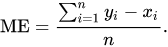

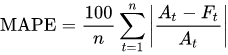

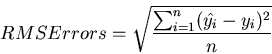

### Average Model 

In [ ]:
# Prediction
aux1 = x_test.copy()
aux1['sales'] = y_test.copy()

aux2 = aux1[['store', 'sales']].groupby('store').mean().reset_index().rename(columns={'sales': 'predictions'})
aux1 = pd.merge(aux1, aux2, how='left', on='store')
yhat_baseline = aux1['predictions']

# Performance
baseline_result = ml_error('Average Model', np.expm1(y_test), np.expm1(yhat_baseline))
baseline_result

,Model Name,MAE,MAPE,MRSE
0,Average Model,1354.800353,0.2064,1835.135542


### Linear Regression 

In [ ]:
# model
lr = LinearRegression().fit(x_train, y_train)

# prediction
yhat_lr = lr.predict(x_test)

# performance
lr_result = ml_error('Linear Regression', np.expm1(y_test), np.expm1(yhat_lr))
lr_result

,Model Name,MAE,MAPE,MRSE
0,Linear Regression,1869.922218,0.295044,2667.521087


#### Linear Regression - Cross validation

In [ ]:
lr_cv = cross_validation(x_training, lr, 'Linear Regression', 5)
lr_cv

,Model,MAE CV,MAPE CV,MRSE CV
0,Linear Regression,2079.28 +- 303.04,0.3 +- 0.02,2961.07 +- 473.32


### Linear Regression Regularized

In [ ]:
# Model
lrr = Lasso(alpha=0.01).fit(x_train, y_train)

# predict
yhat_lrr = lrr.predict(x_test)

# performance
lrr_result = ml_error('Linear Regression Regularized', np.expm1(y_test), np.expm1(yhat_lrr))
lrr_result

,Model Name,MAE,MAPE,MRSE
0,Linear Regression Regularized,1891.194993,0.289872,2741.003248


#### Linear Regression Regularized - Cross validation

In [ ]:
lrr_cv = cross_validation(x_training, lrr, 'Lasso', 5)
lrr_cv

,Model,MAE CV,MAPE CV,MRSE CV
0,Lasso,2116.98 +- 342.05,0.29 +- 0.01,3059.41 +- 504.65


### Random Forest Regressor

In [ ]:
# Model
rf = RandomForestRegressor(n_estimators=100, n_jobs=-1, random_state=42).fit(x_train, y_train)

# Prediction
yhat_rf = rf.predict(x_test)

# Performance
rf_result = ml_error('Random Forest Regressor', np.expm1(y_test), np.expm1(yhat_rf))
rf_result

,Model Name,MAE,MAPE,MRSE
0,Random Forest Regressor,743.435045,0.110389,1092.371159


#### Random Forest Regressor - Cross Validation

In [ ]:
rf_cv = cross_validation(x_training, rf, 'Random Forest Regressor', 5, True)
rf_cv


K number: 5

K number: 4

K number: 3

K number: 2

K number: 1


,Model,MAE CV,MAPE CV,MRSE CV
0,Random Forest Regressor,840.91 +- 223.3,0.12 +- 0.02,1259.56 +- 328.92


### XGBoost Regressor

In [ ]:
# Model
xgb = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, eta=0.01, max_depth=10, subsimple=0.7,
                      colsample_bytee=0.9).fit(x_train, y_train)
# Prediction
yhat_xgb = xgb.predict(x_test)

# Performance
xgb_result = ml_error('XGBoost Regressor', np.expm1(y_test), np.expm1(yhat_xgb))
xgb_result

,Model Name,MAE,MAPE,MRSE
0,XGBoost Regressor,876.306011,0.129724,1273.145439


#### XGBoost Regressor - Cross Validation

In [ ]:
xgb_cv = cross_validation(x_training, xgb, 'XGBoost Regressor', 5, True)
xgb_cv


K number: 5

K number: 4

K number: 3

K number: 2

K number: 1


,Model,MAE CV,MAPE CV,MRSE CV
0,XGBoost Regressor,1059.12 +- 193.55,0.15 +- 0.02,1528.25 +- 272.4


### Compare Models Performance

In [ ]:
modelling_result = pd.concat([baseline_result, lr_result, lrr_result, rf_result, xgb_result])
modelling_result.sort_values('MRSE')

,Model Name,MAE,MAPE,MRSE
0,Random Forest Regressor,743.435045,0.110389,1092.371159
0,XGBoost Regressor,876.306011,0.129724,1273.145439
0,Average Model,1354.800353,0.206400,1835.135542
0,Linear Regression,1869.922218,0.295044,2667.521087
0,Linear Regression Regularized,1891.194993,0.289872,2741.003248


### Real Performance Cross Validation

In [ ]:
modelling_result_cv = pd.concat([lr_cv, lrr_cv, rf_cv, xgb_cv])
modelling_result_cv.sort_values('MRSE CV')

,Model,MAE CV,MAPE CV,MRSE CV
0,Random Forest Regressor,840.91 +- 223.3,0.12 +- 0.02,1259.56 +- 328.92
0,XGBoost Regressor,1059.12 +- 193.55,0.15 +- 0.02,1528.25 +- 272.4
0,Linear Regression,2079.28 +- 303.04,0.3 +- 0.02,2961.07 +- 473.32
0,Lasso,2116.98 +- 342.05,0.29 +- 0.01,3059.41 +- 504.65


# Hyperparameter Fine Tuning

## Random Search

In [2]:
param = {
    'n_estimators': [15, 17, 25, 30, 35],
    'eta': [0.01, 0.03],
    'max_depth': [3, 5, 9],
    'subsample': [0.1, 0.5, 0.9],
    'colsample_bytree': [0.3, 0.7, 0.9],
    'min_child_weight': [3, 8, 15]}

MAX_EVAL = 5

In [3]:
{k: random.sample(v, 1)[0] for k, v in param.items()}

{'n_estimators': 35,
 'eta': 0.03,
 'max_depth': 3,
 'subsample': 0.9,
 'colsample_bytree': 0.9,
 'min_child_weight': 3}

In [12]:
final_result = pd.DataFrame()

for i in range(MAX_EVAL):
  # chose values for parameter randomly
  hp = {k: random.sample(v, 1)[0] for k, v in param.items()}
  print(hp)

  model_xgb = xgb.XGBRegressor(objective='reg:squarederror', 
                         n_estimators=hp['n_estimators'], 
                         eta=hp['eta'], max_depth=hp['max_depth'], 
                         subsimple=hp['subsample'], 
                         colsample_bytee=hp['min_child_weight'])
  
  result = cross_validation(x_training, model_xgb, 'XGBRegressor', 5)
  final_result = pd.concat([final_result, result])

final_result 

{'n_estimators': 35, 'eta': 0.01, 'max_depth': 3, 'subsample': 0.5, 'colsample_bytree': 0.9, 'min_child_weight': 3}
{'n_estimators': 15, 'eta': 0.03, 'max_depth': 9, 'subsample': 0.9, 'colsample_bytree': 0.9, 'min_child_weight': 15}
{'n_estimators': 25, 'eta': 0.01, 'max_depth': 9, 'subsample': 0.5, 'colsample_bytree': 0.7, 'min_child_weight': 8}
{'n_estimators': 25, 'eta': 0.01, 'max_depth': 5, 'subsample': 0.5, 'colsample_bytree': 0.9, 'min_child_weight': 3}
{'n_estimators': 25, 'eta': 0.03, 'max_depth': 9, 'subsample': 0.9, 'colsample_bytree': 0.9, 'min_child_weight': 15}


,Model,MAE CV,MAPE CV,MRSE CV
0,XGBRegressor,2415.4 +- 357.66,0.29 +- 0.02,3426.4 +- 470.97
0,XGBRegressor,6158.5 +- 543.61,0.82 +- 0.01,6859.03 +- 648.82
0,XGBRegressor,3675.96 +- 390.19,0.45 +- 0.02,4500.97 +- 500.25
0,XGBRegressor,3743.24 +- 433.87,0.45 +- 0.02,4653.41 +- 535.75
0,XGBRegressor,3675.96 +- 390.19,0.45 +- 0.02,4500.97 +- 500.25


## Final Model

In [16]:
param_tuned = {
    'n_estimators': 3000,
    'eta': 0.03,
    'max_depth': 5,
    'subsample': 0.7,
    'colsample_bytree': 0.7,
    'min_child_weight': 3
}

In [20]:

xgb_model_tuned = xgb.XGBRegressor(objective='reg:squarederror', 
                                   n_estimators=param_tuned['n_estimators'], 
                                   eta=param_tuned['eta'], 
                                   max_depth=param_tuned['max_depth'],
                                   subsimple=param_tuned['subsample'], 
                                   colsample_bytee=param_tuned['min_child_weight']).fit(x_train, y_train)

yhat_xgb_tuned = xgb_model_tuned.predict(x_test)

xgb_result_tuned = ml_error('XGB Regressor', np.expm1(y_test), 
                            np.expm1(yhat_xgb_tuned))
xgb_result_tuned

[15:39:42] WARNING: ../src/learner.cc:573: 
Parameters: { "colsample_bytee", "subsimple" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




,Model Name,MAE,MAPE,MRSE
0,XGB Regressor,779.099075,0.117633,1115.156211


In [18]:
xgb_result_tuned

,Model Name,MAE,MAPE,MRSE
0,XGB Regressor,681.652667,0.10123,971.368123


## Output

File with all changes made in this step

In [22]:
# xgb model tuned
pickle.dump(xgb_model_tuned, open('../data/models/xgb_model_tuned.pickle', 'wb'))

# Prediction xgb tunned
pickle.dump(yhat_xgb_tuned, open('../data/models/yhat_xgb_tuned.pickle', 'wb'))

# Error Interpretation

## Input File

Previous step file

In [86]:
# Read process data
X_test = pd.read_csv('../data/processing/X_test.csv')
cols_selected_boruta_full = pd.read_csv('../data/processing/cols_selected_boruta_full.csv')
cols_selected_boruta_full.rename(columns={'0': 'variables'}, inplace=True)
cols_selected_boruta_full = cols_selected_boruta_full['variables'].to_list()
yhat_xgb_tuned = pd.read_pickle('../data/models/yhat_xgb_tuned.pickle')

df9 = X_test[cols_selected_boruta_full]
# Rescale
df9['sales'] = np.expm1(df9['sales'])

#yhat_xgb_tuned
df9['predictions'] = np.expm1(yhat_xgb_tuned)

# Date type
df9['date'] = pd.to_datetime(df9['date'])

## Business Performance

In [74]:
# Sum of predictions by store
df91 = df9[['store', 'predictions']].groupby('store').sum().reset_index()

# Mae e Mape
df9_aux1 = df9[['store', 'sales', 'predictions']].groupby('store').apply(lambda x: mean_absolute_error(x['sales'], x['predictions'])).reset_index().rename(columns={0: 'MAE'}) 
df9_aux2 = df9[['store', 'sales', 'predictions']].groupby('store').apply(lambda x: mean_absolute_percentage_error(x['sales'], x['predictions'])).reset_index().rename(columns={0: 'MAPE'}) 

# Merge
df9_aux3 = pd.merge(df9_aux1, df9_aux2, how='inner', on='store')
df92 = pd.merge(df91, df9_aux3, how='inner', on='store')

# Scenarios
df92['worst_scenario'] = df92['predictions'] - df92['MAE']
df92['best_scenario'] = df92['predictions'] + df92['MAE']

# Order columns
df92 = df92[['store', 'predictions', 'worst_scenario', 'best_scenario', 'MAE', 'MAPE']]

In [5]:
# Sum of predictions
df91 = df9[['store', 'predictions']].groupby('store').sum().reset_index()

# Mae e Mape
df9_aux1 = df9[['store', 'sales', 'predictions']].groupby('store').apply(lambda x: mean_absolute_error(x['sales'], x['predictions'])).reset_index().rename(columns={0: 'MAE'}) 
df9_aux2 = df9[['store', 'sales', 'predictions']].groupby('store').apply(lambda x: mean_absolute_percentage_error(x['sales'], x['predictions'])).reset_index().rename(columns={0: 'MAPE'}) 

# Merge
df9_aux3 = pd.merge(df9_aux1, df9_aux2, how='inner', on='store')
df92 = pd.merge(df91, df9_aux3, how='inner', on='store')

# Scenarios
df92['worst_scenario'] = df92['predictions'] - df92['MAE']
df92['best_scenario'] = df92['predictions'] + df92['MAE']

# Order columns
df92 = df92[['store', 'predictions', 'worst_scenario', 'best_scenario', 'MAE', 'MAPE']]

In [75]:
df92.sort_values('MAE', ascending=False).head()

,store,predictions,worst_scenario,best_scenario,MAE,MAPE
908,909,219628.47,211713.64,227543.30,7914.83,0.52
875,876,199268.08,195301.50,203234.66,3966.58,0.32
594,595,386993.47,383149.70,390837.24,3843.77,0.26
841,842,634434.75,630985.21,637884.29,3449.54,0.16
291,292,109096.26,105699.92,112492.60,3396.34,0.61


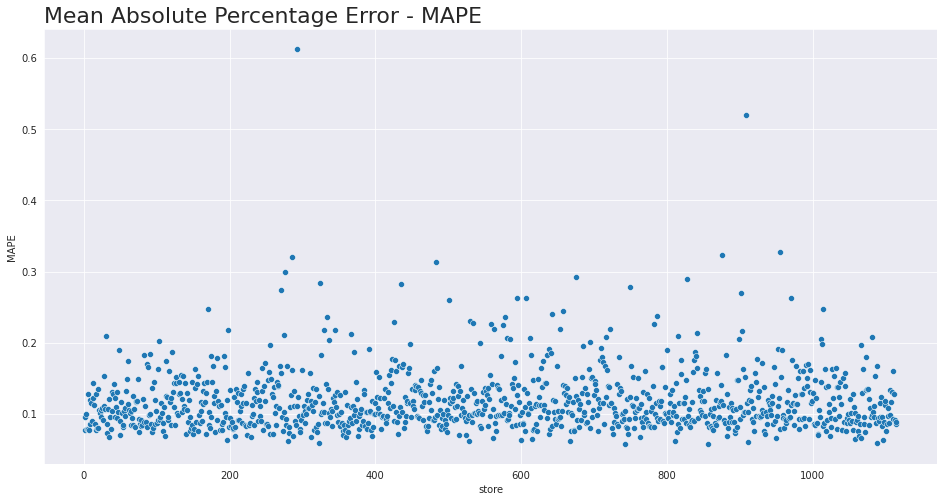

In [76]:
sns.scatterplot(x='store', y='MAPE', data=df92)
plt.title('Mean Absolute Percentage Error - MAPE', fontsize=22, loc='left')
plt.show()

## Total Performance

In [35]:
df93 = df92[['predictions', 'worst_scenario', 'best_scenario']].sum(axis=0).reset_index().rename(columns={'index': 'Scenario', 0: 'Values'})
df93['Values'] = df93['Values'].map('R$ {:,.2f}'.format)
df93

,Scenario,Values
0,predictions,"R$ 288,936,960.00"
1,worst_scenario,"R$ 288,173,160.63"
2,best_scenario,"R$ 289,700,763.82"


## Machine Learning Performance

In [84]:
df9['error'] = df9['sales'] - df9['predictions']
df9['error_rate'] = df9['predictions'] / df9['sales']

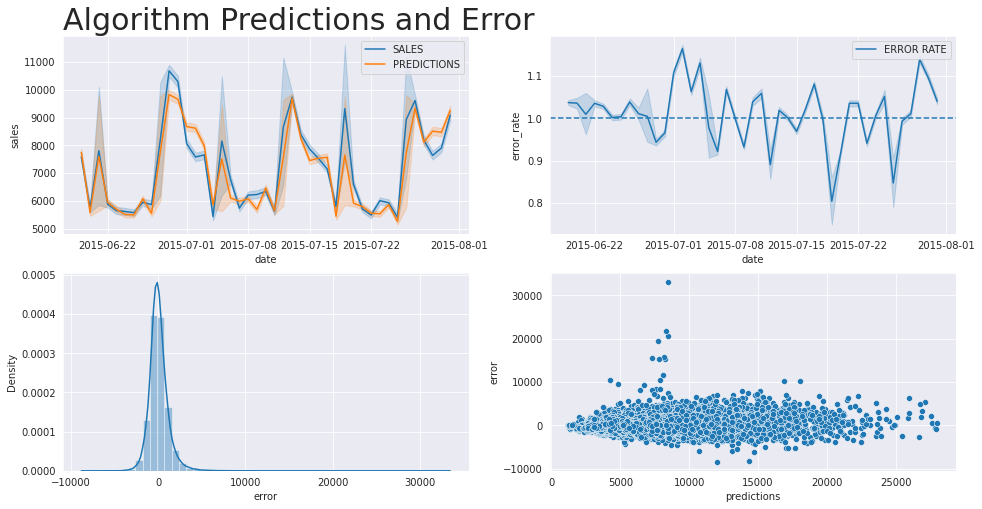

In [85]:
plt.subplot(2, 2, 1)
plt.title('Algorithm Predictions and Error', loc='left', fontsize=30)
sns.lineplot(x='date', y='sales', data=df9, label='SALES')
sns.lineplot(x='date', y='predictions', data=df9, label='PREDICTIONS')

plt.subplot(2, 2, 2)
sns.lineplot(x='date', y='error_rate', data=df9, label='ERROR RATE')
plt.axhline(1, linestyle='--')

plt.subplot(2, 2, 3)
sns.distplot(df9['error'])

plt.subplot(2, 2, 4)
sns.scatterplot(df9['predictions'], df9['error'])
plt.show()

# Deploy Model to Production

<font size=5>Bot API</font>
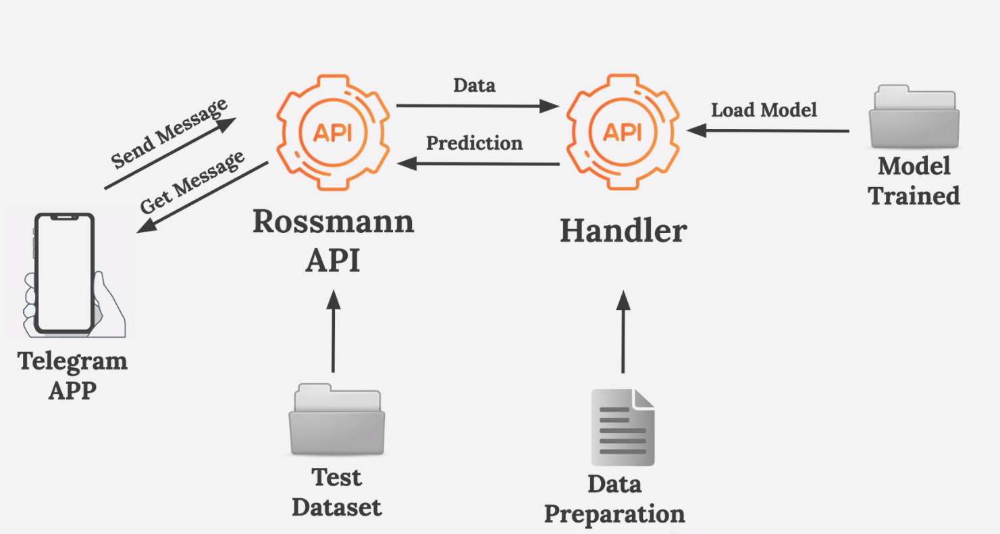
<font size=4>Source: Meigarom Lopes. DS em Produção</font>

## Rossmann Class

In [12]:
class Rossmann:
    '''
    --> Deploy Rossmann prediction model
    '''
    def __init__(self, data=None):
        '''
        :param data: Pandas DataFrame to make a sales predictions
        '''
        self._data = data
        
        
    def data_cleaning(self):
        '''
        --> Cleaning data to properly data types and appropriate format
        '''
        ## Rename Columns
        cols_old = ['Store', 'DayOfWeek', 'Customers', 'Open', 'Promo', 'StateHoliday', 
                             'SchoolHoliday', 'StoreType', 'Assortment', 'CompetitionDistance', 
                             'CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek', 
                             'Promo2SinceYear', 'PromoInterval']

        # Renomeando as colunas para o padrão snacke case
        snackecase = lambda x: inflection.underscore(x)
        cols_new = list(map(snackecase, cols_old))
        self._data.columns = cols_new

        # Types
        self._data['date'] = pd.to_datetime(self._data['date'])

        # Fill NaN            
        self._data['competition_distance'] = self._data['competition_distance'].apply(lambda x: 200000.0 if math.isnan(x) else x)
        self._data['competition_open_since_month'] = self._data.apply(lambda x: x['date'].month if math.isnan(x['competition_open_since_month']) else x['competition_open_since_month'], axis=1)
        self._data['competition_open_since_year'] = self._data.apply(lambda x: x['date'].year if math.isnan(x['competition_open_since_year']) else x['competition_open_since_year'], axis=1)
        self._data['promo2_since_week'] = self._data.apply(lambda x: x['date'].week if math.isnan(x['promo2_since_week']) else x['promo2_since_week'], axis=1)
        self._data['promo2_since_year'] = self._data.apply(lambda x: x['date'].year if math.isnan(x['promo2_since_year']) else x['promo2_since_year'], axis=1)


        # promo_interval

        month_map = {1: 'Jan',
                    2: 'Feb',
                    3: 'Mar',
                    4: 'Apr',
                    5: 'May',
                    6: 'Jun',
                    7: 'Jul',
                    8: 'Aug',
                    9: 'Sep',
                    10: 'Oct',
                    11: 'Nov',
                    12: 'Dec'}

        self._data['promo_interval'].fillna(0, inplace=True)
        self._data['month_map'] = self._data['date'].dt.month.map(month_map)

        df1['is_promo'] = df1[['promo_interval', 'month_map']].apply(lambda x: 0 if x['promo_interval'] == 0 else 1 if x['month_map'] in x['promo_interval'].split(',') else 0, axis=1)

        ## Change Data Types
        df1['competition_open_since_month'] = df1['competition_open_since_month'].astype(int)
        df1['competition_open_since_year'] = df1['competition_open_since_year'].astype(int)
        df1['promo2_since_week'] = df1['promo2_since_week'].astype(int)
        df1['promo2_since_year'] = df1['promo2_since_year'].astype(int)
    
    
    def feature_engenering(self):
        '''
        --> Create news features to model performance
        '''
        ### Feature Engineering
        # year
        self._data['year'] = self._data['date'].dt.year

        # month
        self._data['month'] = self._data['date'].dt.month

        # day
        self._data['day'] = self._data['date'].dt.day

        # week of year
        self._data['week_of_year'] = self._data['date'].dt.isocalendar().week

        # year week
        self._data['year_week'] = self._data['date'].dt.strftime('%Y-%W')

        # competition since
        self._data['competition_since'] = self._data.apply(lambda x: datetime(year=x['competition_open_since_year'], month=x['competition_open_since_month'], day=1), axis=1)
        self._data['competition_time_month'] = ((self._data['date'] - self._data['competition_since']) / 30).apply(lambda x: x.days).astype(int)

        # promo since
        self._data['promo_since'] = self._data['promo2_since_year'].astype(str) + '-' + self._data['promo2_since_week'].astype(str)
        self._data['promo_since'] = self._data['promo_since'].apply(lambda x: datetime.strptime(x + '-1', '%Y-%W-%w') - timedelta(days=7))
        self._data['promo_time_week'] = ((self._data['date'] - self._data['promo_since']) / 7).apply(lambda x: x.days).astype(int)

        # Assortment
        self._data['assortment'] = self._data['assortment'].apply(lambda x: 'basic' if x == 'a' else 'extra' if x == 'b'else 'extended')

        # state holiday
        self._data['state_holiday'] = self._data['state_holiday'].apply(lambda x: 'public_holiday' if x == 'a' else 'easter_holiday' if x == 'b' else 'christmas' if x == 'c' else 'regular_day')

        ## Data Filter
        ### Row Filter
        #self._data = self._data[(self._data['open'] != 0) & (self._data['sales'] > 0)]

        ### Columns Filter
        self._data.drop(['open', 'promo_interval', 'month_map'], axis=1, inplace=True)
    
    
    def data_preparation(self):
        '''
        --> Data preparation to Machine Learning model
        '''
        ## Rescaling
        mms = MinMaxScaler()
        rs = RobustScaler()

        # Robust Scaler
        # competition_distance
        self._data['competition_distance'] = rs.fit_transform(self._data[['competition_distance']].values)

        # competition_time_month
        self._data['competition_time_month'] = rs.fit_transform(self._data[['competition_time_month']].values)

        # Min Max Scaler
        # promo_time_week
        self._data['promo_time_week'] = mms.fit_transform(self._data[['promo_time_week']].values)

        # year
        self._data['year'] = mms.fit_transform(self._data[['year']].values)

        ### Encoding
        # State Holiday - OheHotEncoding
        self._data = pd.get_dummies(self._data, prefix=['state_holiday'], columns=['state_holiday'])

        # Store Type - Label Encoding
        le = LabelEncoder()
        self._data['store_type'] = le.fit_transform(self._data['store_type'])

        # Assortment - Ordina encoding
        store_type = {'basic': 1, 'extra': 2, 'extended': 3}
        self._data['assortment'] = self._data['assortment'].map(store_type)

        ### Response Variable Transformation
        # response variable normalization
        self._data['sales'] = np.log1p(self._data['sales'])

        ### Nature Transformation 
        # day_of_week
        self._data['day_of_week_sin'] = self._data['day_of_week'].apply(lambda x: np.sin(x * (2 * np.pi / 7)))
        self._data['day_of_week_cos'] = self._data['day_of_week'].apply(lambda x: np.cos(x * (2 * np.pi / 7)))

        # month
        self._data['month_sin'] = self._data['month'].apply(lambda x: np.sin(x * (2 * np.pi / 12)))
        self._data['month_cos'] = self._data['month'].apply(lambda x: np.cos(x * (2 * np.pi / 12)))

        #day
        df3['day_sin'] = df3['day'].apply(lambda x: np.sin(x * (2 * np.pi / 30)))
        df3['day_cos'] = df3['day'].apply(lambda x: np.cos(x * (2 * np.pi / 30)))

        # week_of_year
        self._data['week_of_year_sin'] = self._data['week_of_year'].apply(lambda x: np.sin(x * (2 * np.pi / 52)))
        self._data['week_of_year_cos'] = self._data['week_of_year'].apply(lambda x: np.cos(x * (2 * np.pi / 52)))

        cols_selected_boruta = [
         'store',
         'promo',
         'store_type',
         'assortment',
         'competition_distance',
         'competition_open_since_month',
         'competition_open_since_year',
         'promo2',
         'promo2_since_week',
         'promo2_since_year',
         'competition_time_month',
         'promo_time_week',
         'day_of_week_sin',
         'day_of_week_cos',
         'month_cos',
         'day_sin',
         'day_cos',
         'week_of_year_cos'
        ]

        self._data = self._data[cols_selected_boruta] 
    
    
    def get_prediction(self, model, raw_data, test_date):
        '''
        --> Realize the prediction of sales
        
        :param model: Machine Learning to be use
        :param raw_data: DataFrame Pandas with raw data
        :param test_date: Data to be predict
        '''
        # prediction
        pred = model.predict(test_date)
        
        # join prediction to original data
        raw_data['prediction'] = np.expm1(pred)
        
        return raw_data.to_json(orient='records', data_format='iso')

## API Handler

In [ ]:
model = pickle.load(open('/home/marcos/Documents/data_science_em_producao/data/models/xgb_result_tuned.pickle', 'rb'))

app = Flask(__name__)

@app.route('/rossmann/predict', methods=['POST'])
def rossmann_predict():
    test_json = request.get_json()
    
    if test_json: # there is data
        if isinstance(test_json, dict): # unique example
            test_raw = pd.DataFrame(test_json, index=[0])
        else: # multiple example
            test_raw = pd.DataFrame(test_json, columns=test_json[0].keys())
            
        # Instantiate Rossman Class
        pipeline = Rossmann(test_raw)
        pipeline.data_cleaning()
        pipeline.feature_engenering()
        pipeline.data_preparation()
        pipeline.get_prediction()
        return pipeline.get_prediction(model, test_raw)
    else:
        return Response('{}', status=200, mimetype='application/json')

if __name__ == '__main__':
    app.run('0.0.0.0')

 * Serving Flask app '__main__' (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on all addresses.
 * Running on http://192.168.0.61:5000/ (Press CTRL+C to quit)
192.168.0.61 - - [11/Oct/2021 22:48:35] "GET / HTTP/1.1" 404 -
192.168.0.61 - - [11/Oct/2021 22:48:35] "GET /favicon.ico HTTP/1.1" 404 -
192.168.0.61 - - [11/Oct/2021 22:52:19] "GET / HTTP/1.1" 404 -


## API Tester

In [4]:
df10 = pd.read_csv('../data/rossmann-store-sales/test.csv')
df_test = pd.merge(df10, df_store_raw, how='left', on='Store')

df_test = df_test[df_test['Store'].isin([100, 200, 300])]
df_test = df_test[df_test['Open'] != 0]
df_test = df_test[~df_test['Open'].isnull()]
df_test.drop('Id', axis=1, inplace=True)

In [5]:
data = json.dumps(df_test.to_dict(orient='records'))

In [6]:
# API call
#url = 'http://0.0.0.0:5000/rossmann/predict'
url = 'https://sales-rossmann-prediction.herokuapp.com/rossmann/predict'
header = {'Content-type': 'application/json'}

r = requests.post(url, data=data, headers=header)
print(f'Status Code {r.status_code}')

Status Code 200


In [7]:
d1 = pd.DataFrame(r.json(), columns=r.json()[0].keys())
d2 = d1[['store', 'prediction']].groupby('store').sum().reset_index()
d2

,store,prediction
0,100,321635.760254
1,200,289829.403809
2,300,213387.520020


In [8]:
for i in range(len(d2)):
    print(f'Store: {d2.loc[i, "store"]}')
    print(f'Prediction: ${d2.loc[i, "prediction"]:,.2f} (next 6 weeks)\n')    

Store: 100
Prediction: $321,635.76 (next 6 weeks)

Store: 200
Prediction: $289,829.40 (next 6 weeks)

Store: 300
Prediction: $213,387.52 (next 6 weeks)



# Contact Info

<font size=5>Marcos Galvão</font>

<font size=4.5>Porfolio</font>: www.marcosgalvao.com.br

<font size=4.5>Linkedin</font>: https://www.linkedin.com/in/marcosrmgalvao/

<font size=4.5>Telegram Bot</font>: https://t.me/RossmannSalesBot